<a href="https://colab.research.google.com/github/mariux255/AOOP/blob/master/Explanatory_Notebook_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Motivation

## What is the dataset?


The dataset is the motor vehicle collisions dataset for the city of New York.  Each row represents a crash event. The Motor Vehicle Collisions data tables contain information from all police reported motor vehicle collisions in NYC. The police report (MV104-AN) is required to be filled out for collisions where someone is injured or killed, or where there is at least $1000 worth of damage.

## Why did you choose this/these particular dataset(s)?

First and Foremost, the primary reason for choosing this dataset was that it matched very well with the scope of our analysis. 

The motor vehicle collisions dataset is very clean and extensive (29 columns and 1.7M rows). It has geographical information (Latitude and Longitude) which opened the gateway to a wide variety of geographical analysis. Also, the colums like Vehicle type, reason for the accidents, number of fatalies (injured and deaths) in terms of pedestrians, cyclists and motorists provided extensive possibilites.






## What was your goal for the end user's experience?

The goal was to give the user (NYPD) a visual experience of the collisions for the city of New York. 

1) Doing some exploratory and explanatory analysis to show them the possibilites a rich dataset like this can provide and help in solving the problem of collisions in the city.

2)Once the user realizes these possibilities, giving them a plethora of interactive visualizations which they can then use to drive further analysis, as they are the real domain experts.

#Imports and Data Loading

In [1]:
pip install geopandas

In [2]:
pip install plotly

In [3]:
pip install dash

In [4]:
pip install jupyter_dash

In [5]:
import dash
import dash_core_components as dcc
import dash_html_components as html
import plotly.graph_objs as go
from jupyter_dash import JupyterDash
import plotly.express as px

In [6]:
import pandas as pd
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
import geopandas as gpd

In [7]:
import folium
from folium import plugins
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster
from folium import IFrame
import ipywidgets
from ipywidgets import interact, interact_manual

In [8]:
import seaborn as sns
plt.style.use("seaborn-darkgrid")

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.tree import DecisionTreeClassifier

from bokeh.plotting import show, figure
from bokeh.io import output_notebook
from bokeh.resources import INLINE
from bokeh.palettes import Spectral6, Category20, Set3, Spectral
from bokeh.transform import factor_cmap
import itertools  
from bokeh.models import ColumnDataSource, FactorRange, Legend
output_notebook()

In [9]:
# Mount drive if using colab
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [10]:
#filepath =  'drive/My Drive/Social Data Analysis and Visualization/Motor_Vehicle_Collisions_-_Crashes.csv'
#filepath =  'C:/Users/Sameer Agarwal/Downloads/Motor_Vehicle_Collisions_-_Crashes.csv'
filepath = 'drive/My Drive/Motor_Vehicle_Collisions_-_Crashes.csv'
collisions_df_load = pd.read_csv(filepath, sep=',', error_bad_lines=False, index_col=False, dtype='unicode')

#Dataset Exploration (Basic Stats)

Basic data processing in terms of removing NaNs, changing data types and column names and extracting data and time information. (Removing NaNs did not change the relative volume of data)

In [11]:
collisions_df_original = collisions_df_load

In [12]:
print(collisions_df_original.shape)
collisions_df_original.head()

(1778804, 29)


,CRASH DATE,CRASH TIME,BOROUGH,ZIP CODE,LATITUDE,LONGITUDE,LOCATION,ON STREET NAME,CROSS STREET NAME,OFF STREET NAME,NUMBER OF PERSONS INJURED,NUMBER OF PERSONS KILLED,NUMBER OF PEDESTRIANS INJURED,NUMBER OF PEDESTRIANS KILLED,NUMBER OF CYCLIST INJURED,NUMBER OF CYCLIST KILLED,NUMBER OF MOTORIST INJURED,NUMBER OF MOTORIST KILLED,CONTRIBUTING FACTOR VEHICLE 1,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,COLLISION_ID,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5
0,04/14/2021,5:32,NaN,NaN,NaN,NaN,NaN,BRONX WHITESTONE BRIDGE,NaN,NaN,0,0,0,0,0,0,0,0,Following Too Closely,Unspecified,NaN,NaN,NaN,4407480,Sedan,Sedan,NaN,NaN,NaN
1,04/13/2021,21:35,BROOKLYN,11217,40.68358,-73.97617,"(40.68358, -73.97617)",NaN,NaN,620 ATLANTIC AVENUE,1,0,1,0,0,0,0,0,Unspecified,NaN,NaN,NaN,NaN,4407147,Sedan,NaN,NaN,NaN,NaN
2,04/15/2021,16:15,NaN,NaN,NaN,NaN,NaN,HUTCHINSON RIVER PARKWAY,NaN,NaN,0,0,0,0,0,0,0,0,Pavement Slippery,NaN,NaN,NaN,NaN,4407665,Station Wagon/Sport Utility Vehicle,NaN,NaN,NaN,NaN
3,04/13/2021,16:00,BROOKLYN,11222,NaN,NaN,NaN,VANDERVORT AVENUE,ANTHONY STREET,NaN,0,0,0,0,0,0,0,0,Following Too Closely,Unspecified,NaN,NaN,NaN,4407811,Sedan,NaN,NaN,NaN,NaN
4,04/12/2021,8:25,NaN,NaN,0,0,"(0.0, 0.0)",EDSON AVENUE,NaN,NaN,0,0,0,0,0,0,0,0,Unspecified,Unspecified,NaN,NaN,NaN,4406885,Station Wagon/Sport Utility Vehicle,Sedan,NaN,NaN,NaN


Aggregations, filtering and sorting is done to find a starting point for ananalysis

In [13]:
collisions_no_nan = collisions_df_original[collisions_df_original['LOCATION'].notna()]

In [14]:
borough_count = collisions_df_original['BOROUGH'].value_counts(dropna = False)

In [15]:
borough_names = collisions_df_original['BOROUGH'].unique()
print(borough_names)

[nan 'BROOKLYN' 'QUEENS' 'STATEN ISLAND' 'BRONX' 'MANHATTAN']


In [16]:
nan_count = collisions_df_original.isna().sum()
nan_count

CRASH DATE                             0
CRASH TIME                             0
BOROUGH                           547237
ZIP CODE                          547449
LATITUDE                          210055
LONGITUDE                         210055
LOCATION                          210055
ON STREET NAME                    359459
CROSS STREET NAME                 628612
OFF STREET NAME                  1511713
NUMBER OF PERSONS INJURED             18
NUMBER OF PERSONS KILLED              31
NUMBER OF PEDESTRIANS INJURED          0
NUMBER OF PEDESTRIANS KILLED           0
NUMBER OF CYCLIST INJURED              0
NUMBER OF CYCLIST KILLED               0
NUMBER OF MOTORIST INJURED             0
NUMBER OF MOTORIST KILLED              0
CONTRIBUTING FACTOR VEHICLE 1       5024
CONTRIBUTING FACTOR VEHICLE 2     253058
CONTRIBUTING FACTOR VEHICLE 3    1658983
CONTRIBUTING FACTOR VEHICLE 4    1752918
CONTRIBUTING FACTOR VEHICLE 5    1772020
COLLISION_ID                           0
VEHICLE TYPE COD

In [17]:
collisions_no_nan.groupby('ON STREET NAME').size().sort_values().iloc[-15:]

ON STREET NAME
BRUCKNER BOULEVARD                   6534
5 AVENUE                             6546
FDR DRIVE                            6746
FLATBUSH AVENUE                      7801
QUEENS BOULEVARD                     7833
GRAND CENTRAL PKWY                   8022
LINDEN BOULEVARD                     8589
2 AVENUE                             8771
BROOKLYN QUEENS EXPRESSWAY           8897
LONG ISLAND EXPRESSWAY               9225
NORTHERN BOULEVARD                  10272
3 AVENUE                            11575
BELT PARKWAY                        12096
ATLANTIC AVENUE                     14190
BROADWAY                            15962
dtype: int64

Most frequent on streets.

Broadway (Manhattan), Atlantic avenue(Brooklyn/Queens), Belt parkway (Brooklyn), 3rd avenue (Manhattan) and Northern boulevard (Queens) are the top 5 streets with the most collisions. These are long streets that connect distant parts of the city. Several of them are central (Broadway, 3rd avenue). This results in a lot of traffic flow on them.

In [18]:
collisions_no_nan.groupby('CROSS STREET NAME').size().sort_values().iloc[-15:]

CROSS STREET NAME
MADISON AVENUE                      3477
9 AVENUE                            3514
2 AVENUE                            3730
6 AVENUE                            4056
LEXINGTON AVENUE                    4206
PARK AVENUE                         4291
BROADWAY                            4582
3 AVENUE                            5034
1 AVENUE                            5116
7 AVENUE                            6390
8 AVENUE                            6471
5 AVENUE                            6937
2 AVENUE                            8309
BROADWAY                            8951
3 AVENUE                            9084
dtype: int64

Most frequent cross streets

3rd avenue, Broadway, 2nd avenue, 5th avenue, 8th avenue are all in Manhattan, central location of New York. These areas are most likely crowded which results in busy intersections and streets which difficult driving conditions and many collisions.

In [19]:
collisions_no_nan.groupby(['ON STREET NAME','CROSS STREET NAME']).size().sort_values().iloc[-15:]

ON STREET NAME                    CROSS STREET NAME               
EAST 59 STREET                    3 AVENUE                            258
WEST FORDHAM ROAD                 MAJOR DEEGAN EXPRESSWAY             261
FLATBUSH AVENUE EXTENSION         TILLARY STREET                      265
                                  TILLARY STREET                      265
EAST 34 STREET                    2 AVENUE                            270
EAST 36 STREET                    2 AVENUE                            276
WEST 42 STREET                    7 AVENUE                            289
EAST 57 STREET                    2 AVENUE                            298
WEST 34 STREET                    7 AVENUE                            299
EAST 57 STREET                    3 AVENUE                            305
WEST FORDHAM ROAD                 MAJOR DEEGAN EXPRESSWAY             316
TILLARY STREET                    FLATBUSH AVENUE EXTENSION           320
BRUCKNER BOULEVARD                EAST 138 ST

Most frequent intersections

1. WEST 42 STREET                    8 AVENUE (Manhattan)

2. EAST 59 STREET                    2 AVENUE (Manhattan) | Ed Koch Queensboro Bridge

3. BRUCKNER BOULEVARD                EAST 138 STREET (Bronx) | Bruckner Expy

4. TILLARY STREET                    FLATBUSH AVENUE EXTENSION (Brooklyn) | Brooklyn Queens Expy

5. WEST FORDHAM ROAD                 MAJOR DEEGAN EXPRESSWAY (Bronx) | Major Deegan Expy

Several of these intersections (2,3,4,5) are an exit or near an exit from some busy road (as listed near the names of the intersections).

In [20]:
collisions_no_nan['LONGITUDE'] = pd.to_numeric(collisions_no_nan['LONGITUDE']) 
collisions_no_nan = collisions_no_nan.drop(collisions_no_nan[collisions_no_nan['LONGITUDE'] < -75].index)
collisions_no_nan = collisions_no_nan.drop(collisions_no_nan[collisions_no_nan['LONGITUDE'] > -70].index)
collisions_no_nan['CRASH DATE'] = pd.to_datetime(collisions_no_nan['CRASH DATE'])
mask = (collisions_no_nan['CRASH DATE'] > '2018-01-01') & (collisions_no_nan['CRASH DATE'] < '2019-01-01')
collisions_2018 = collisions_no_nan.loc[mask]

#Data Analysis

##Temporal Analysis

###Quick Temporal Analysis to look at accidents by Month, Year and Hour of the day

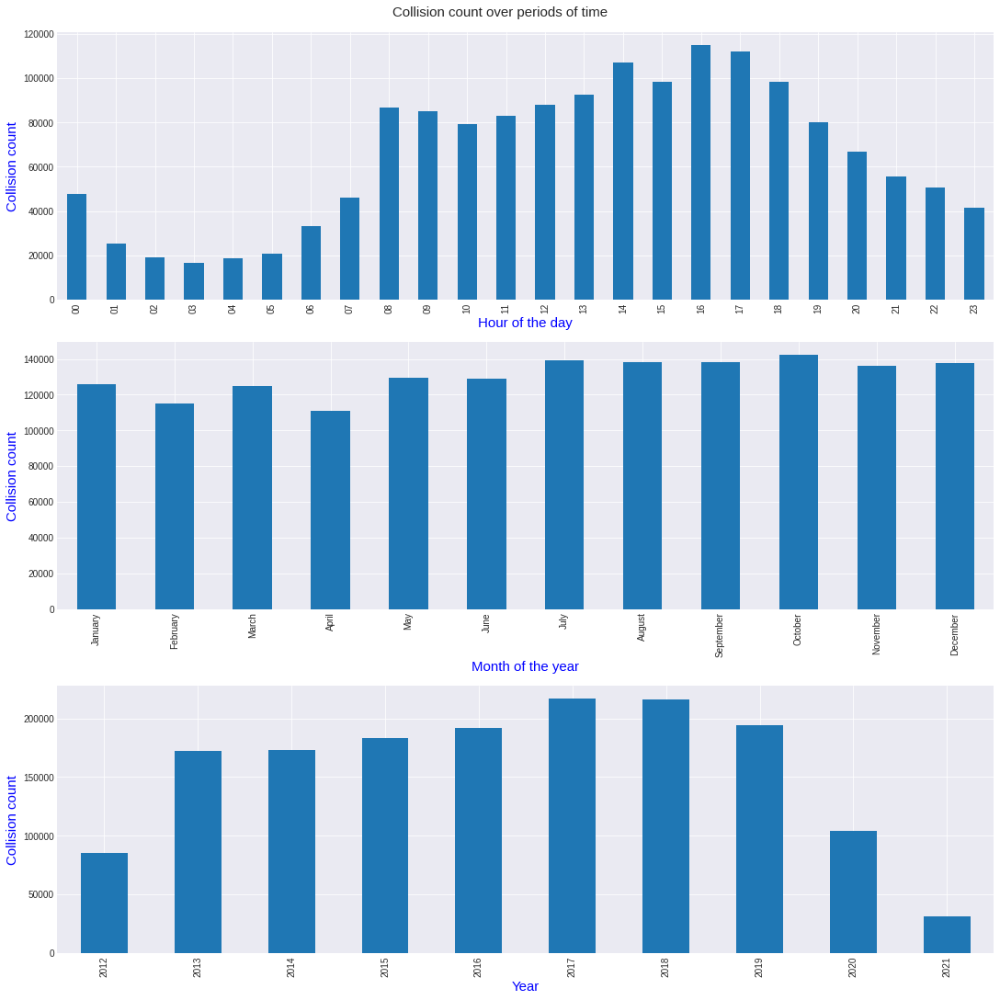

In [21]:
fig, axes = plt.subplots(nrows=3, ncols=1, figsize = (15, 15), constrained_layout = True)
fig.suptitle('Collision count over periods of time', fontsize = 15)
axes.flatten()

#Figure for collisions vs time of day
collisions_no_nan['HOUR'] = pd.to_datetime(collisions_no_nan['CRASH TIME']).dt.strftime('%H')
collisions_count_hour = collisions_no_nan.groupby('HOUR').size()
collisions_count_hour.plot(kind = 'bar', ax = axes[0])

axes[0].set_xlabel('Hour of the day', color='b', fontsize = 15)
axes[0].set_ylabel('Collision count', color='b', fontsize = 15)
#Figure for collisions vs month of year
months = ['January', 'February', 'March','April','May' ,'June','July','August', 'September', 'October', 'November', 'December']
collisions_no_nan['MONTH'] = pd.to_datetime(collisions_no_nan['CRASH DATE']).dt.strftime('%B')
collisions_count_month = collisions_no_nan.groupby('MONTH').size()
collisions_count_month = collisions_count_month.reindex(months, axis=0)
collisions_count_month.plot(kind = 'bar', ax = axes[1])

axes[1].set_xlabel('Month of the year', color='b', fontsize = 15)
axes[1].set_ylabel('Collision count', color='b', fontsize = 15)
#Figure for collisions vs year
collisions_no_nan['YEAR'] = pd.to_datetime(collisions_no_nan['CRASH DATE']).dt.strftime('%Y')
collisions_count_year = collisions_no_nan.groupby('YEAR').size()
collisions_count_year.plot(kind = 'bar', ax = axes[2])

axes[2].set_xlabel('Year', color='b', fontsize = 15)
axes[2].set_ylabel('Collision count', color='b', fontsize = 15)

plt.show()

From the first part of the visualization above it can be seen that there are two main parts of the day were the collision count goes up. It is the morning commute, which happens at 8 AM. And it is the commute from work, which is around 4PM. The collision count is much higher in the evening. It is hard to tell why. The amount of vehicles on the road is unknown. Bigger flow of vehicles could lead to more collisions. The reason for many collisions at the time of commuting from work could be fatigue. Fatigue from work could lead to lack of attention.

From the second part of the visualization it can be seen that the collision numbers are highest from July until December. It is unknown why this is happening. The reason could be that from January until June the cold weather and snow results in worse road conditions. That is why the drivers have to be more cautious.

In the third part of the visualization several different things can be seen. First, the years 2012 and 2021 are incomplete which results in such low numbers of collisions. Second, a clear impact of COVID-19 can be seen in year 2020, where the number of collisions is much lower compared to the other years. Third, the number of collisions was growin steadily from years 2014 until 2017. The reason for this could be a higher usage of ride sharing or just an increase of traffic.

###Interactive graph to look at the same aggregations

In [22]:
collisions_no_nan['CRASH DATE'] =  pd.to_datetime(collisions_no_nan['CRASH DATE'], infer_datetime_format=True)
years_in_df = collisions_no_nan['CRASH DATE'].dt.strftime('%Y').unique()
months = ['January', 'February','March', 'April','May','June','July','August','September','October','November','December']
years_in_df.sort()

temp = []
for year in years_in_df:
    temp_df = collisions_no_nan[collisions_no_nan['YEAR'] == year]
    collisions_count_month = temp_df.groupby('MONTH').size()
    for month in months:
        try :
            collisions_count_month[month]
        except:
            collisions_count_month[month] = 0
    #df_len = len(temp_df.index)
    #divided = collisions_count_month.apply(lambda x: x/df_len)
    
    temp.append((year,collisions_count_month))

In [23]:
year, data = temp.pop(0)
normalized_year_df = pd.DataFrame(data, columns=[year])
for i, (year, data) in enumerate(temp):
    normalized_year_df[year] = data

source_data = ColumnDataSource(normalized_year_df)

Another way of looking at the same dataset, this time with interacction

In [24]:
colors = itertools.cycle(Set3[12]) 
months = normalized_year_df.index.values
months = ['January', 'February','March', 'April','May','June','July','August','September','October','November','December']
p = figure(x_range = FactorRange(factors=months), plot_height=550, plot_width = 1100, title="Collisions per month", x_axis_label='Month', y_axis_label='Count') #p is a standard way to call figures in Bokeh

bar ={}
items = []
for indx,(crime,color) in enumerate(zip(years_in_df, colors)):
    bar[crime] = p.vbar(x='MONTH',  top=crime, source=source_data, muted_alpha=0.01,muted = True, color = color, width=0.7)
    items.append((crime, [bar[crime]])) ### figure where to add it
    
legend = Legend(items=items, location=(0, 120))
p.add_layout(legend, 'left')

p.legend.click_policy="mute"

p.axis.major_label_text_font_size = "15px"
p.xaxis.axis_label_text_font_size = '14pt'
p.yaxis.axis_label_text_font_size = '14pt'
p.title.text_font_size = '15pt'
p.title.align = 'center'

show(p)


Above we have an interactive graph made using bokeh. It showcases the number of collisions for every month of some year. The specific year can be chosen.

The first thing to point out is the incomplete data in years 2012 and 2021. This was mentioned previously.

To further analyse the data, the years 2013 and 2014 are very similar with respect to the distrbiution of collisions over the months and the total number of collisions per year. In year 2015 an overall increase of collisions for majority of the months can be seen. Year 2016 is interesting. There is a steady decrease from January to April. The number of collisions in April 2016 is low compared to the same month of previous years. The reason for this is unknown. After April the number of collisions increase and are higher for every month compared to the numbers of previous years. Year 2017 shows an increase of collisions for almost every month compared to year 2016. Year 2018 shows similar numbers and a similar distribution of collisions compared to year 2017. Year 2019 shows a decrease of collisions for every month of the year compared to year 2018. From year 2020 a drastic decrease in collision can be seen. These are the effects of COVID-19. The number of collisions are really low in April of 2020. This is the month when heave lockdowns were present in many cities including New York. Year 2021 shows low numbers of collisions which continue from July of 2020.

It is hard to derive some trends for number of collisions through out a year. But it seems that the number of collisions per month is highest in May and June and lowest in February. This is probably related to the weather. The weather imapacts the conditions of the road and social behaviour. Drivers might be more cautious when the road conditions are bad. On top of that, people might want to be outside more and head somewhere when the weather gets better (the transition from colder to warmer weather) as in May and July.

###Temporal Analysis w.r.t the time of the day and the cause of the accident

In [25]:
b = [0,4,8,12,16,20,24]
l = ['Late Night', 'Early Morning','Morning','Noon','Eve','Night']
collisions_no_nan["TIMEOFDAY"] = pd.cut(pd.to_datetime(collisions_no_nan["CRASH TIME"]).dt.hour, bins=b, labels=l, include_lowest=True)

In [26]:
def factor_df(factor):
    indexes = collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 1'] == factor
    indexes2 = collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 2'] == factor
    indexes3 = collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 3'] == factor
    indexes_all = indexes | indexes2 | indexes3
    speeding_collisions = collisions_no_nan[indexes_all]
    print(speeding_collisions.shape)

    return speeding_collisions


In [27]:
def n_inj_kill (df):
    persons_injured = df.index[df['NUMBER OF PERSONS INJURED'] > '0'].tolist()
    pedestrians_injured = df.index[df['NUMBER OF PEDESTRIANS INJURED'] > '0'].tolist()
    cyclists_injured = df.index[df['NUMBER OF CYCLIST INJURED'] > '0'].tolist()
    motorists_injured = df.index[df['NUMBER OF MOTORIST INJURED'] > '0'].tolist()

    persons_killed = df.index[df['NUMBER OF PERSONS KILLED'] > '0'].tolist()
    pedestrians_killed = df.index[df['NUMBER OF PEDESTRIANS KILLED'] > '0'].tolist()
    cyclists_killed = df.index[df['NUMBER OF CYCLIST KILLED'] > '0'].tolist()
    motorists_killed = df.index[df['NUMBER OF MOTORIST KILLED'] > '0'].tolist()

    injured = list(set(persons_injured + pedestrians_injured + cyclists_injured + motorists_injured))
    killed = list(set(persons_killed + pedestrians_killed + cyclists_killed + motorists_killed))

    return injured, killed

In [28]:
collisions_no_nan.groupby('CONTRIBUTING FACTOR VEHICLE 1').size().sort_values().iloc[-20:]

CONTRIBUTING FACTOR VEHICLE 1
View Obstructed/Limited            10093
Prescription Medication            13004
Reaction to Uninvolved Vehicle     14429
Pavement Slippery                  15116
Alcohol Involvement                15637
Unsafe Speed                       16269
Lost Consciousness                 16927
Driver Inexperience                23650
Traffic Control Disregarded        24904
Unsafe Lane Changing               29929
Fatigued/Drowsy                    37439
Turning Improperly                 37902
Passing Too Closely                38217
Passing or Lane Usage Improper     40048
Other Vehicular                    49514
Backing Unsafely                   61465
Following Too Closely              79329
Failure to Yield Right-of-Way      92902
Driver Inattention/Distraction    306469
Unspecified                       555831
dtype: int64

In [29]:
Unsafe_Speed_collisions = factor_df('Unsafe Speed')
Fatigue_collisions = factor_df('Fatigued/Drowsy')
Alcohol_Involvement_collisions = factor_df('Alcohol Involvement')
Backing_Unsafely_collisions = factor_df('Backing Unsafely')
Lost_Consciousness_collisions = factor_df('Lost Consciousness')

factor_df_list = []
factor_df_list.append(Unsafe_Speed_collisions)
factor_df_list.append(Fatigue_collisions)
factor_df_list.append(Alcohol_Involvement_collisions)
factor_df_list.append(Backing_Unsafely_collisions)
factor_df_list.append(Lost_Consciousness_collisions)
factor_df_list.append(collisions_no_nan)

(19181, 33)
(42731, 33)
(16422, 33)
(66268, 33)
(19038, 33)


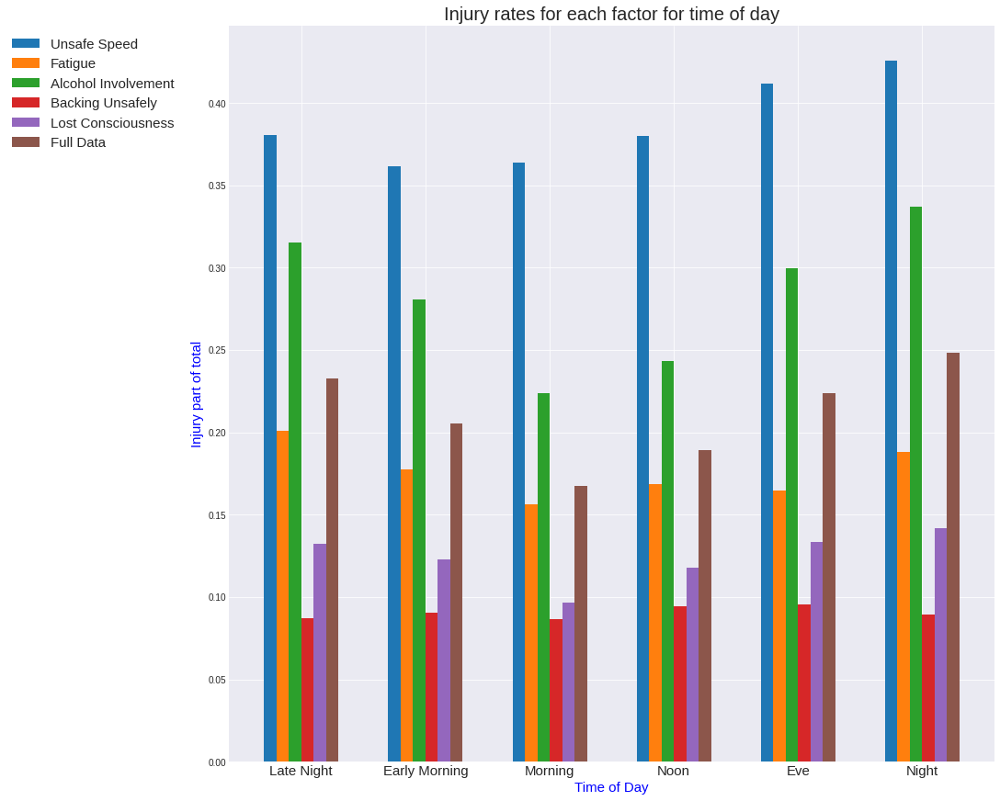

In [30]:
fig, ax = plt.subplots(figsize = (15, 12), constrained_layout = True)


label_list = ['Unsafe Speed', 'Fatigue', 'Alcohol Involvement', 'Backing Unsafely', 'Lost Consciousness','Full Data']
df_values = []
for df in factor_df_list:
    inside_list = []
    injured, killed = n_inj_kill(df)
    temp = df.loc[injured].groupby('TIMEOFDAY').size() / df.groupby('TIMEOFDAY').size()
    inside_list.append(temp.values)
    temp = df.loc[killed].groupby('TIMEOFDAY').size() / df.groupby('TIMEOFDAY').size()
    inside_list.append(temp.values)
    
    df_values.append(inside_list)

    
X = list(temp.index.values)
Ygirls = [10,20,20,40]
Zboys = [20,30,25,30]
  
X_axis = np.arange(len(X)) * 2

for i,values in enumerate(df_values):
    
    plt.bar(X_axis - 0.5 + (i * 0.2), values[0], 0.2, label = label_list[i])
  
plt.xticks(X_axis, X, fontsize = 15)
plt.xlabel("Time of Day", fontsize = 15, color = 'b')
plt.ylabel("Injury part of total", fontsize = 15, color = 'b')
plt.title("Injury rates for each factor for time of day", fontsize = 20)
plt.legend(fontsize = 15, bbox_to_anchor=(-0.3, 1), loc='upper left')
plt.show()

In the visualization above the injury rates of several different contributing factors are reviewed. The impact of 'Unsafe Speed', 'Fatigue', 'Alcohol Involvement', 'Backing Unsafely', 'Lost Consciousness' is compared to the injury rates of the full data. An injury rate is calculated by dividing the amount of collisions resulting in injuries by the total number of collisions for that contributing factor. These factors are computed for different parts of the day.


*   00:00 - 04:00 Late Night
*   04:00 - 08:00 Early Morning
*   08:00 - 12:00 Morning
*   12:00 - 16:00 Noon
*   16:00 - 20:00 Eve
*   20:00 - 24:00 Night


It can be seen that the involvment of speeding and alcohol increases the risk of a collision resulting in injuries. These numbers are high for the periods of Night and Late Night. This is probably because the visibilty is reduced at these times. This combined with the poor choices of the driver results in such high risks. Fatigue, backing unsafely and lost consciousness result in smaller risks of injuries. The results of fatigue and lost consciousness are suprising. I would imagine that a fatigued driver might have worse reaction times and orientation capabilities similar to when one is intoxicated. One could think that losing conscious might also result in severe collisions but the graph shows otherwise. Backing unsafely shows expected results. Such condition would result in slow speed of the vehicle which does not result in strong collisions and severe results.



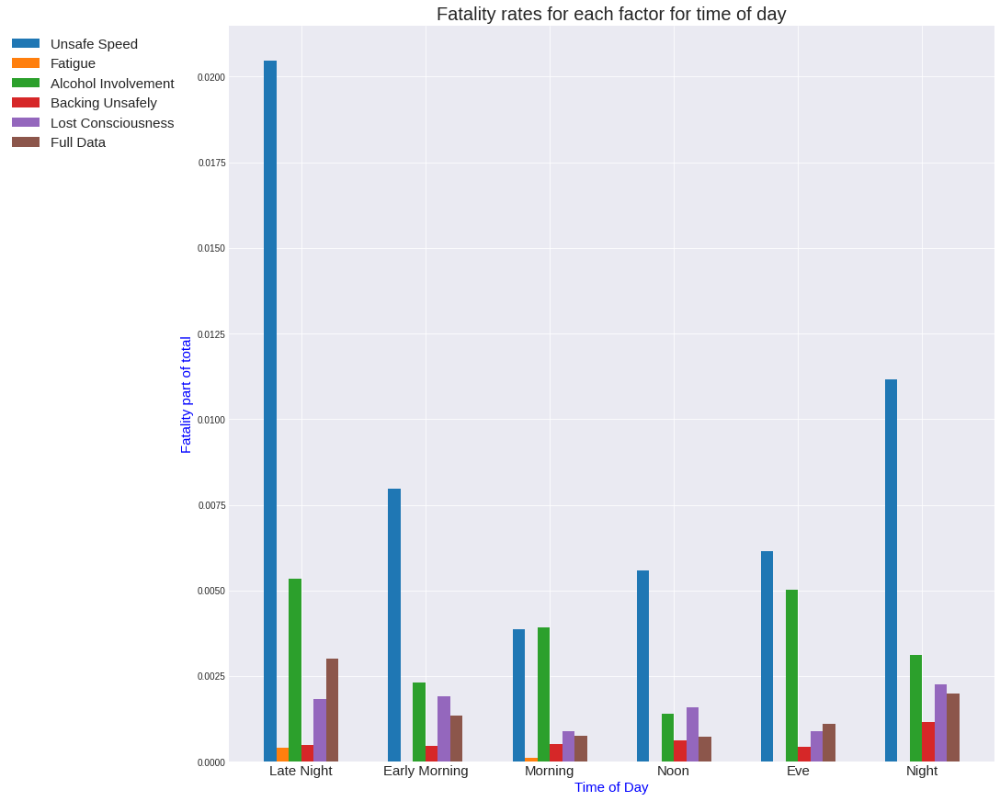

In [31]:
fig, ax = plt.subplots(figsize = (15, 12), constrained_layout = True)


label_list = ['Unsafe Speed', 'Fatigue', 'Alcohol Involvement', 'Backing Unsafely', 'Lost Consciousness','Full Data']
df_values = []
for df in factor_df_list:
    inside_list = []
    injured, killed = n_inj_kill(df)
    temp = df.loc[injured].groupby('TIMEOFDAY').size() / df.groupby('TIMEOFDAY').size()
    inside_list.append(temp.values)
    temp = df.loc[killed].groupby('TIMEOFDAY').size() / df.groupby('TIMEOFDAY').size()
    inside_list.append(temp.values)
    
    df_values.append(inside_list)

    
X = list(temp.index.values)
Ygirls = [10,20,20,40]
Zboys = [20,30,25,30]
  
X_axis = np.arange(len(X)) * 2

for i,values in enumerate(df_values):
    
    plt.bar(X_axis - 0.5 + (i * 0.2), values[1], 0.2, label = label_list[i])
  
plt.xticks(X_axis, X, fontsize = 15)
plt.xlabel("Time of Day", fontsize = 15, color = 'b')
plt.ylabel("Fatality part of total", fontsize = 15, color = 'b')
plt.title("Fatality rates for each factor for time of day", fontsize = 20)
plt.legend(fontsize = 15, bbox_to_anchor=(-0.3, 1), loc='upper left')
plt.show()

In the visualization above the fatality rates of several different contributing factors are reviewed. The impact of 'Unsafe Speed', 'Fatigue', 'Alcohol Involvement', 'Backing Unsafely', 'Lost Consciousness' is compared to the fatality rates of the full data. A fatality rate is calculated by dividing the amount of collisions resulting in fatalities by the total number of collisions for that contributing factor. These factors are computed for different parts of the day as defined before.

The most noticable thing in the visualization is the huge rate of fatalities for 'Unsafe Speed' durin the Late Night period. More than 2 percent of the collisions result in fatalities compared to the rate of 0.25 percent for the full data for the same period of time. The risk of fatalities is high for every period of time when the contributing factor is speeding. This does make sense but the numbers are still suprising. 'Alcohol Involvement' also leads to higher rates of fatalities compared to the fatality rates for the full data. This was also expected as intoxicated drivers might have slower reaction times and less awareness. The rate of fatalities is higher for most of the time periods when the contributing factor is 'Lost Consciousness'. Higher rates were expected for this. Since a vehicle might get out of control when the driver is basically not present. For 'Fatigue' and 'Backing Unsafely' the fatality rates are lower than for the full data. Similar to the injury rates, the rates of fatigue are unexpected. One could imagine that a fatigued driver might behave in some regards similar to an intoxicated driver. So higher fatality rates would be expected. The rates of unsafe backing makes sense. This does not result in high speeds, which leads to less severe collisions.

##Machine Learning - Decision Tree

In [32]:
collisions_no_nan = collisions_no_nan[collisions_no_nan['NUMBER OF PERSONS INJURED'].notna()]
collisions_no_nan = collisions_no_nan[collisions_no_nan['NUMBER OF PERSONS KILLED'].notna()]
collisions_no_nan['BOROUGH'] = collisions_no_nan['BOROUGH'].fillna('NOT DEFINED')
collisions_no_nan['ZIP CODE'] = collisions_no_nan['ZIP CODE'].fillna('NOT DEFINED')
collisions_no_nan['ON STREET NAME'] = collisions_no_nan['ON STREET NAME'].fillna('NOT DEFINED')
collisions_no_nan['CROSS STREET NAME'] = collisions_no_nan['CROSS STREET NAME'].fillna('NOT DEFINED')
collisions_no_nan['OFF STREET NAME'] = collisions_no_nan['OFF STREET NAME'].fillna('NOT DEFINED')
collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 1'] = collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 1'].fillna('NOT DEFINED')
collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 2'] = collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 2'].fillna('NOT DEFINED')
collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 3'] = collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 3'].fillna('NOT DEFINED')
collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 4'] = collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 4'].fillna('NOT DEFINED')
collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 5'] = collisions_no_nan['CONTRIBUTING FACTOR VEHICLE 5'].fillna('NOT DEFINED')
collisions_no_nan['VEHICLE TYPE CODE 1'] = collisions_no_nan['VEHICLE TYPE CODE 1'].fillna('NOT DEFINED')
collisions_no_nan['VEHICLE TYPE CODE 2'] = collisions_no_nan['VEHICLE TYPE CODE 2'].fillna('NOT DEFINED')
collisions_no_nan['VEHICLE TYPE CODE 3'] = collisions_no_nan['VEHICLE TYPE CODE 3'].fillna('NOT DEFINED')
collisions_no_nan['VEHICLE TYPE CODE 4'] = collisions_no_nan['VEHICLE TYPE CODE 4'].fillna('NOT DEFINED')
collisions_no_nan['VEHICLE TYPE CODE 5'] = collisions_no_nan['VEHICLE TYPE CODE 5'].fillna('NOT DEFINED')

In [33]:
collisions_no_nan['HOUR'] = pd.to_numeric(collisions_no_nan['HOUR'])
collisions_no_nan['YEAR'] = pd.to_numeric(collisions_no_nan['YEAR'])
collisions_no_nan['LONGITUDE'] = pd.to_numeric(collisions_no_nan['LONGITUDE'])
collisions_no_nan['LATITUDE'] = pd.to_numeric(collisions_no_nan['LATITUDE'])
collisions_no_nan['NUMBER OF PERSONS INJURED'] = pd.to_numeric(collisions_no_nan['NUMBER OF PERSONS INJURED'])
collisions_no_nan['NUMBER OF PERSONS KILLED'] = pd.to_numeric(collisions_no_nan['NUMBER OF PERSONS KILLED'])
collisions_no_nan['NUMBER OF PEDESTRIANS INJURED'] = pd.to_numeric(collisions_no_nan['NUMBER OF PEDESTRIANS INJURED'])
collisions_no_nan['NUMBER OF PEDESTRIANS KILLED'] = pd.to_numeric(collisions_no_nan['NUMBER OF PEDESTRIANS KILLED'])
collisions_no_nan['NUMBER OF CYCLIST INJURED'] = pd.to_numeric(collisions_no_nan['NUMBER OF CYCLIST INJURED'])
collisions_no_nan['NUMBER OF CYCLIST KILLED'] = pd.to_numeric(collisions_no_nan['NUMBER OF CYCLIST KILLED'])
collisions_no_nan['NUMBER OF MOTORIST INJURED'] = pd.to_numeric(collisions_no_nan['NUMBER OF MOTORIST INJURED'])
collisions_no_nan['NUMBER OF MOTORIST KILLED'] = pd.to_numeric(collisions_no_nan['NUMBER OF MOTORIST KILLED'])
#collisions_no_nan['MONTH'] = pd.to_numeric(collisions_no_nan['MONTH'])

In [34]:
nan_count = collisions_no_nan.isna().sum()

nan_count

CRASH DATE                       0
CRASH TIME                       0
BOROUGH                          0
ZIP CODE                         0
LATITUDE                         0
LONGITUDE                        0
LOCATION                         0
ON STREET NAME                   0
CROSS STREET NAME                0
OFF STREET NAME                  0
NUMBER OF PERSONS INJURED        0
NUMBER OF PERSONS KILLED         0
NUMBER OF PEDESTRIANS INJURED    0
NUMBER OF PEDESTRIANS KILLED     0
NUMBER OF CYCLIST INJURED        0
NUMBER OF CYCLIST KILLED         0
NUMBER OF MOTORIST INJURED       0
NUMBER OF MOTORIST KILLED        0
CONTRIBUTING FACTOR VEHICLE 1    0
CONTRIBUTING FACTOR VEHICLE 2    0
CONTRIBUTING FACTOR VEHICLE 3    0
CONTRIBUTING FACTOR VEHICLE 4    0
CONTRIBUTING FACTOR VEHICLE 5    0
COLLISION_ID                     0
VEHICLE TYPE CODE 1              0
VEHICLE TYPE CODE 2              0
VEHICLE TYPE CODE 3              0
VEHICLE TYPE CODE 4              0
VEHICLE TYPE CODE 5 

In [35]:
from sklearn.preprocessing import LabelEncoder

features = collisions_no_nan[['LATITUDE', 'LONGITUDE', 'CONTRIBUTING FACTOR VEHICLE 1', 'CONTRIBUTING FACTOR VEHICLE 2', 'CONTRIBUTING FACTOR VEHICLE 3', 'CONTRIBUTING FACTOR VEHICLE 4', 'CONTRIBUTING FACTOR VEHICLE 5', 'VEHICLE TYPE CODE 1','VEHICLE TYPE CODE 2', 'VEHICLE TYPE CODE 3', 'VEHICLE TYPE CODE 4', 'VEHICLE TYPE CODE 5', 'HOUR', 'MONTH', 'YEAR']]

le = LabelEncoder()

features['CONTRIBUTING FACTOR VEHICLE 1'] = le.fit_transform(features['CONTRIBUTING FACTOR VEHICLE 1'])
features['CONTRIBUTING FACTOR VEHICLE 2'] = le.fit_transform(features['CONTRIBUTING FACTOR VEHICLE 2'])
features['CONTRIBUTING FACTOR VEHICLE 3'] = le.fit_transform(features['CONTRIBUTING FACTOR VEHICLE 3'])
features['CONTRIBUTING FACTOR VEHICLE 4'] = le.fit_transform(features['CONTRIBUTING FACTOR VEHICLE 4'])
features['CONTRIBUTING FACTOR VEHICLE 5'] = le.fit_transform(features['CONTRIBUTING FACTOR VEHICLE 5'])
features['VEHICLE TYPE CODE 1'] = le.fit_transform(features['VEHICLE TYPE CODE 1'])
features['VEHICLE TYPE CODE 2'] = le.fit_transform(features['VEHICLE TYPE CODE 2'])
features['VEHICLE TYPE CODE 3'] = le.fit_transform(features['VEHICLE TYPE CODE 3'])
features['VEHICLE TYPE CODE 4'] = le.fit_transform(features['VEHICLE TYPE CODE 4'])
features['VEHICLE TYPE CODE 5'] = le.fit_transform(features['VEHICLE TYPE CODE 5'])
features['MONTH'] = le.fit_transform(features['MONTH'])

In [36]:
collisions_no_nan['Injury/Fatality'] = np.where((collisions_no_nan['NUMBER OF PERSONS INJURED'] > 0) | (collisions_no_nan['NUMBER OF PERSONS KILLED'] > 0 ) | (collisions_no_nan['NUMBER OF PEDESTRIANS INJURED'] > 0) | (collisions_no_nan['NUMBER OF PEDESTRIANS KILLED'] > 0 ) | (collisions_no_nan['NUMBER OF CYCLIST INJURED'] > 0) | (collisions_no_nan['NUMBER OF CYCLIST KILLED'] > 0 ) | (collisions_no_nan['NUMBER OF MOTORIST INJURED'] > 0) | (collisions_no_nan['NUMBER OF MOTORIST KILLED'] > 0 ), 1, 0)
index, counts = np.unique(collisions_no_nan['Injury/Fatality'].values,return_counts=True)
print(counts[0])
print(counts[1])
print(counts[1] / counts.sum())

1246563
320218
0.2043795527262585


In [37]:
labels = collisions_no_nan['Injury/Fatality']

In [38]:
X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=1)

y_train.value_counts()

0    996719
1    256705
Name: Injury/Fatality, dtype: int64

In [39]:
full_df = X_train
full_df['label'] = y_train
full_df

,LATITUDE,LONGITUDE,CONTRIBUTING FACTOR VEHICLE 1,CONTRIBUTING FACTOR VEHICLE 2,CONTRIBUTING FACTOR VEHICLE 3,CONTRIBUTING FACTOR VEHICLE 4,CONTRIBUTING FACTOR VEHICLE 5,VEHICLE TYPE CODE 1,VEHICLE TYPE CODE 2,VEHICLE TYPE CODE 3,VEHICLE TYPE CODE 4,VEHICLE TYPE CODE 5,HOUR,MONTH,YEAR,label
1092134,40.594555,-73.997568,19,57,49,37,14,843,605,85,46,25,19,10,2015,1
1394953,40.687751,-73.969783,57,57,25,19,14,666,739,78,35,25,8,8,2014,0
158238,40.709854,-73.743970,57,29,25,19,14,695,556,78,35,25,11,2,2019,0
1135097,40.586552,-73.966168,57,57,25,19,14,666,874,78,35,25,17,1,2015,0
869891,40.835484,-73.949400,56,57,25,19,14,695,556,78,35,25,20,9,2016,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
900518,40.717278,-73.995440,11,33,25,19,14,695,765,78,35,25,16,11,2016,0
533341,40.719000,-73.825470,11,18,25,19,14,695,777,78,35,25,22,7,2018,1
511673,40.761770,-73.979065,11,11,25,19,14,709,765,78,35,25,0,0,2018,0
533867,40.747894,-73.989174,11,11,49,19,14,765,828,122,35,25,21,7,2018,1


In [40]:
from sklearn.utils import resample


print(features.shape)

df_majority = full_df[full_df['label']==0]
df_minority = full_df[full_df['label']==1]

# Upsample minority class
df_minority_upsampled = resample(df_minority, 
                                 replace=True,     # sample with replacement
                                 n_samples=994401,    # to match majority class
                                 random_state=42) # reproducible results

# Combine majority class with upsampled minority class
df_upsampled = pd.concat([df_majority, df_minority_upsampled])

# Display new class counts
df_upsampled.label.value_counts()

(1566781, 15)


0    996719
1    994401
Name: label, dtype: int64

In [41]:
features_upsampled = df_upsampled.iloc[:,:-1]
labels_upsampled = df_upsampled.iloc[:,-1]

In [42]:
X_train = X_train.iloc[:,:-1]

In [43]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split, GridSearchCV



random_forest = DecisionTreeClassifier()

param_grid = {
    'max_depth': range(2,21),
}

search = GridSearchCV( random_forest,param_grid, n_jobs=-1)
search.fit(X_train,y_train)

GridSearchCV(cv=None, error_score=nan,
             estimator=DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features=None,
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              presort='deprecated',
                                              random_state=None,
                                              splitter='best'),
             iid='deprecated', n_jobs=-1,
             param_grid={'max_depth': range(2, 21)}, pre_dispatch='2*n_jobs',

In [44]:
print(search.best_score_)
print(search.best_params_)

0.8381968112450788
{'max_depth': 11}


In [45]:
# Decision tree on unbalanced data

random_forest = DecisionTreeClassifier(max_depth = 11, random_state=1)
random_forest.fit(X_train,y_train)
random_forest.score(X_test, y_test)

0.839713170600944

In [46]:
# Decision tree on balanced data

random_forest = DecisionTreeClassifier(max_depth = 11, random_state=1)
random_forest.fit(features_upsampled,labels_upsampled)
random_forest.score(X_test, y_test)

0.780164476938444

In [47]:
# from sklearn.ensemble import AdaBoostClassifier
# random_f = AdaBoostClassifier(DecisionTreeClassifier(max_depth= 11))
# random_f.fit(X_train,y_train)
# random_f.score(X_test, y_test)
# Takes too long. Accuracy is 0.82786

In [48]:
# random_f = AdaBoostClassifier(DecisionTreeClassifier(max_depth= 11))
# random_f.fit(features_upsampled,labels_upsampled)
# random_f.score(X_test, y_test)
# Takes too long. Accuracy is 0.74789

In [49]:
# Logistic regression on unbalanced data

from sklearn.linear_model import LogisticRegression

logistic_regression = LogisticRegression()
logistic_regression.fit(X_train,y_train)
logistic_regression.score(X_test,y_test)

0.7941772483142231

In [50]:
# Logistic regression on balanced data


logistic_regression = LogisticRegression()
logistic_regression.fit(features_upsampled,labels_upsampled)
logistic_regression.score(X_test,y_test)

0.6749936972845668

In [51]:
# To create a small tree

random_forest = DecisionTreeClassifier(max_depth = 3, random_state=1)
random_forest.fit(X_train,y_train)
random_forest.score(X_test, y_test)

0.8098718075549612

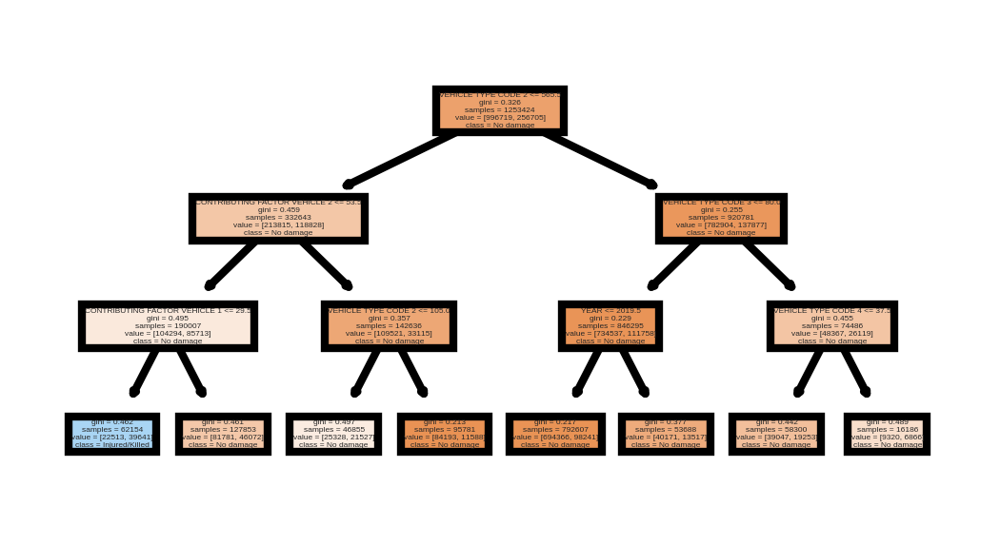

In [52]:
from sklearn.tree import plot_tree

fn=['LATITUDE', 'LONGITUDE', 'CONTRIBUTING FACTOR VEHICLE 1', 'CONTRIBUTING FACTOR VEHICLE 2', 'CONTRIBUTING FACTOR VEHICLE 3', 'CONTRIBUTING FACTOR VEHICLE 4', 'CONTRIBUTING FACTOR VEHICLE 5', 'VEHICLE TYPE CODE 1','VEHICLE TYPE CODE 2', 'VEHICLE TYPE CODE 3', 'VEHICLE TYPE CODE 4', 'VEHICLE TYPE CODE 5', 'HOUR', 'MONTH', 'YEAR']
cn=['No damage','Injured/Killed']
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (2,1), dpi=600)
plot_tree(random_forest,
               feature_names = fn, 
               class_names=cn,
               filled = True);
fig.savefig('imagename.png')


The above decision tree showcases how different variables influence if a collision will be severe. 
These variables were given to the algorithm:
'LATITUDE', 'LONGITUDE', 'CONTRIBUTING FACTOR VEHICLE 1', 'CONTRIBUTING FACTOR VEHICLE 2', 'CONTRIBUTING FACTOR VEHICLE 3', 'CONTRIBUTING FACTOR VEHICLE 4', 'CONTRIBUTING FACTOR VEHICLE 5', 'VEHICLE TYPE CODE 1','VEHICLE TYPE CODE 2', 'VEHICLE TYPE CODE 3', 'VEHICLE TYPE CODE 4', 'VEHICLE TYPE CODE 5', 'HOUR', 'MONTH', 'YEAR'
The max depth was set to 3, so the tree could be visualized. A collision would be severe if the second contributing vehicle is one of the first 555 vehicle types ('PASSENGER VEHICLE', 'VAN', 'LARGE COM VEH(6 OR MORE TIRES)' and so on), if the factor of the second contributing vehicle is on of the first 53 (Unspecified, Driver inattention, failure to yield right-of-way and so on) and if the factor of the first contributing vehicle is the first of 29 (similar to the previous condition). Note this tree does not give accurate prediction results and is not very deep. Because of that the interpretation of the splits is not so informative. A way to improve the algorithm would be to merge some of the vehicle types since 1220 are listed.


If we wanted to predict if a collision will be severe an algorithm was used for this. The accuracy for it was 0.839713170600944. A decision tree with max_depth 11 was used and it was trained on an unbalanced dataset.

## Interactive Bar Graphs in Dash 
With the interactive graphs, the idea is to be able to explore the major components of the dataset viz. No of collisions, injuries and deaths across Boroughs as well as the reasons for the collisions

### A general graph showing all the top contributing factors
(61 contributing factors grouped together based on similarity by inspection to create 26)

In [53]:
contributing_factors1 = collisions_df_original[['CONTRIBUTING FACTOR VEHICLE 1', 'BOROUGH', 'NUMBER OF PERSONS INJURED', 'NUMBER OF PERSONS KILLED']]
# combining and Simplifing contributing factors (from 61 -> 26)
contributing_factors1['CONTRIBUTING FACTOR VEHICLE 1'].replace({'Texting': 'Cell Phone Usage', 'Cell Phone (hand-Held)': 'Cell Phone Usage', 'Cell Phone (hand-held)': 'Cell Phone Usage', 'Cell Phone (hands-free)': 'Cell Phone Usage', '80': 'Unspecified', '1': 'Unspecified', 'Outside Car Distraction': 'Driver Inattention/Distraction', 'Passenger Distraction': 'Driver Inattention/Distraction', 'Drugs (Illegal)': 'Drugs/Prescription Medication', 'Drugs (illegal)': 'Drugs/Prescription Medication', 'Prescription Medication': 'Drugs/Prescription Medication', 'Fatigued/Drowsy': 'Fatigued/Drowsy/Lost Consciousness/Fell Asleep', 'Fell Asleep': 'Fatigued/Drowsy/Lost Consciousness/Fell Asleep', 'Lost Consciousness': 'Fatigued/Drowsy/Lost Consciousness/Fell Asleep', 'Illnes': 'Illness/Physical Disability', 'Illness': 'Illness/Physical Disability', 'Physical Disability': 'Illness/Physical Disability', 'Glare': 'View Obstructed/Limited', 'Obstruction/Debris': 'View Obstructed/Limited', 'Windshield Inadequate': 'View Obstructed/Limited', 'Tinted Windows': 'View Obstructed/Limited', 'Lane Marking Improper/Inadequate': 'Lane Marking/Pavement Defective/Inadequate', 'Pavement Defective': 'Lane Marking/Pavement Defective/Inadequate', 'Shoulders Defective/Improper': 'Lane Marking/Pavement Defective/Inadequate', 'Reaction to Other Uninvolved Vehicle': 'Other Vehicular', 'Reaction to Uninvolved Vehicle': 'Other Vehicular', 'Passing or Lane Usage Improper': 'Passing or Lane Usage/Changing Improper/Unsafe', 'Passing Too Closely': 'Passing or Lane Usage/Changing Improper/Unsafe', 'Unsafe Lane Changing': 'Passing or Lane Usage/Changing Improper/Unsafe', 'Failure to Keep Right': 'Passing or Lane Usage/Changing Improper/Unsafe', 'Listening/Using Headphones': 'Using Headphones/other Electronic Device', 'Using On Board Navigation Device': 'Using Headphones/other Electronic Device', 'Other Electronic Device': 'Using Headphones/other Electronic Device', 'Headlights Defective': 'Vehicle Inadequate/Defective', 'Vehicle Vandalism': 'Vehicle Inadequate/Defective', 'Other Lighting Defects': 'Vehicle Inadequate/Defective', 'Tow Hitch Defective': 'Vehicle Inadequate/Defective', 'Steering Failure': 'Vehicle Inadequate/Defective', 'Brakes Defective': 'Vehicle Inadequate/Defective', 'Tire Failure/Inadequate': 'Vehicle Inadequate/Defective', 'Accelerator Defective': 'Vehicle Inadequate/Defective', 'Driver Inexperience': 'Driver Inexperience/Oversized Vehicle', 'Oversized Vehicle': 'Driver Inexperience/Oversized Vehicle', 'Traffic Control Disregarded': 'Traffic Control/Speed Limits Disregarded', 'Unsafe Speed': 'Traffic Control/Speed Limits Disregarded'}, inplace=True)
contributing_factors1['COUNTS'] = 1.0

# Drop all NaN Boroughs since they dont give the insight wwe need
contributing_factors1 = contributing_factors1[contributing_factors1['BOROUGH'].notna()]
contributing_factors_combined1 = contributing_factors1.astype({"NUMBER OF PERSONS INJURED": float, "NUMBER OF PERSONS KILLED": float})

In [54]:
contributing_factors_combined1 = contributing_factors_combined1.groupby(['CONTRIBUTING FACTOR VEHICLE 1','BOROUGH']).agg({'NUMBER OF PERSONS INJURED': 'sum', 'NUMBER OF PERSONS KILLED': 'sum', 'COUNTS': 'sum'})
contributing_factors_combined1

NUMBER OF PERSONS INJURED  ...  COUNTS
CONTRIBUTING FACTOR VEHICLE 1 BOROUGH                                   ...        
Aggressive Driving/Road Rage  BRONX                              485.0  ...   995.0
                              BROOKLYN                           679.0  ...  1544.0
                              MANHATTAN                          377.0  ...  1128.0
                              QUEENS                             382.0  ...  1101.0
                              STATEN ISLAND                       75.0  ...   183.0
...                                                                ...  ...     ...
View Obstructed/Limited       BRONX                              801.0  ...  2226.0
                              BROOKLYN                          1532.0  ...  3861.0
                              MANHATTAN                          629.0  ...  2345.0
                              QUEENS                            1356.0  ...  3508.0
                              STATEN ISLAND                      204.0  ...   629.0

[130 rows x 3 columns]

In [55]:
contributing_factors_BRONX = contributing_factors_combined1.iloc[contributing_factors_combined1.index.get_level_values('BOROUGH') == 'BRONX']
contributing_factors_BRONX = contributing_factors_BRONX.droplevel(1)
contributing_factors_QUEENS = contributing_factors_combined1.iloc[contributing_factors_combined1.index.get_level_values('BOROUGH') == 'QUEENS']
contributing_factors_QUEENS = contributing_factors_QUEENS.droplevel(1)
contributing_factors_BROOKLYN = contributing_factors_combined1.iloc[contributing_factors_combined1.index.get_level_values('BOROUGH') == 'BROOKLYN']
contributing_factors_BROOKLYN = contributing_factors_BROOKLYN.droplevel(1)
contributing_factors_MANHATTAN = contributing_factors_combined1.iloc[contributing_factors_combined1.index.get_level_values('BOROUGH') == 'MANHATTAN']
contributing_factors_MANHATTAN = contributing_factors_MANHATTAN.droplevel(1)
contributing_factors_STATENISLAND = contributing_factors_combined1.iloc[contributing_factors_combined1.index.get_level_values('BOROUGH') == 'STATEN ISLAND']
contributing_factors_STATENISLAND = contributing_factors_STATENISLAND.droplevel(1)

In [56]:
# Deleting unspecified since they give no insight 
contributing_factors_BRONX = contributing_factors_BRONX.drop("Unspecified", axis=0)
contributing_factors_QUEENS = contributing_factors_QUEENS.drop("Unspecified", axis=0)
contributing_factors_BROOKLYN = contributing_factors_BROOKLYN.drop("Unspecified", axis=0)
contributing_factors_MANHATTAN = contributing_factors_MANHATTAN.drop("Unspecified", axis=0)
contributing_factors_STATENISLAND = contributing_factors_STATENISLAND.drop("Unspecified", axis=0)

In [57]:
contributing_factors_ALL = contributing_factors_BRONX
contributing_factors_ALL = contributing_factors_ALL.add(contributing_factors_QUEENS, fill_value=0)
contributing_factors_ALL = contributing_factors_ALL.add(contributing_factors_BROOKLYN, fill_value=0)
contributing_factors_ALL = contributing_factors_ALL.add(contributing_factors_MANHATTAN, fill_value=0)
contributing_factors_ALL = contributing_factors_ALL.add(contributing_factors_STATENISLAND, fill_value=0)

In [58]:
contributing_factors_ALL['COUNTS'].sum()

743009.0

In [59]:
contributing_factors_ALL.sort_values(by='COUNTS', ascending=False)

,NUMBER OF PERSONS INJURED,NUMBER OF PERSONS KILLED,COUNTS
CONTRIBUTING FACTOR VEHICLE 1,,,
Driver Inattention/Distraction,66971.0,205.0,239237.0
Failure to Yield Right-of-Way,35341.0,180.0,76028.0
Passing or Lane Usage/Changing Improper/Unsafe,8551.0,18.0,74780.0
Backing Unsafely,5622.0,30.0,53059.0
Other Vehicular,9920.0,21.0,49219.0
Fatigued/Drowsy/Lost Consciousness/Fell Asleep,9041.0,21.0,43603.0
Following Too Closely,11418.0,15.0,39503.0
Turning Improperly,5080.0,10.0,29335.0
Traffic Control/Speed Limits Disregarded,17769.0,223.0,29247.0


By dropping the bottom 7 categories we get a much better view of the graph while only loosing 0.8% af collisions, Staten Island is the only one that does not have the same bottom 7 contributing factors but to keep the graph in sync, we alwasy drop the same 7 factors.

In [60]:
contributing_factors_ALL_top = contributing_factors_ALL.drop(contributing_factors_ALL[contributing_factors_ALL.COUNTS < 2000].index)
contributing_factors_BRONX_top = contributing_factors_BRONX.drop(contributing_factors_BRONX[contributing_factors_BRONX.COUNTS < 800].index)
contributing_factors_BROOKLYN_top = contributing_factors_BROOKLYN.drop(contributing_factors_BROOKLYN[contributing_factors_BROOKLYN.COUNTS < 1000].index)
contributing_factors_MANHATTAN_top = contributing_factors_MANHATTAN.drop(contributing_factors_MANHATTAN[contributing_factors_MANHATTAN.COUNTS < 1000].index)
contributing_factors_QUEENS_top = contributing_factors_QUEENS.drop(contributing_factors_QUEENS[contributing_factors_QUEENS.COUNTS < 600].index)
contributing_factors_STATENISLAND_top = contributing_factors_STATENISLAND.drop(contributing_factors_STATENISLAND[contributing_factors_STATENISLAND.COUNTS < 100].index)
contributing_factors_STATENISLAND_top = contributing_factors_STATENISLAND_top.drop(contributing_factors_STATENISLAND_top[contributing_factors_STATENISLAND_top.COUNTS == 197].index)

In [61]:
contributing_factors_STATENISLAND_top.sort_values(by='COUNTS', ascending=False)

,NUMBER OF PERSONS INJURED,NUMBER OF PERSONS KILLED,COUNTS
CONTRIBUTING FACTOR VEHICLE 1,,,
Driver Inattention/Distraction,2805.0,12.0,10311.0
Failure to Yield Right-of-Way,1452.0,8.0,3109.0
Backing Unsafely,176.0,0.0,2302.0
Passing or Lane Usage/Changing Improper/Unsafe,265.0,1.0,1963.0
Following Too Closely,588.0,2.0,1950.0
Other Vehicular,353.0,0.0,1707.0
Fatigued/Drowsy/Lost Consciousness/Fell Asleep,416.0,2.0,1579.0
Traffic Control/Speed Limits Disregarded,775.0,15.0,1404.0
Turning Improperly,255.0,0.0,1033.0


Exporting the resulting data to JSON which will be used for creating the website

In [62]:
contributing_factors_ALL_top.to_json(r'contributing_factors_ALL_top.json')
contributing_factors_BRONX_top.to_json(r'contributing_factors_BRONX_top.json')
contributing_factors_BROOKLYN_top.to_json(r'contributing_factors_BROOKLYN_top.json')
contributing_factors_MANHATTAN_top.to_json(r'contributing_factors_MANHATTAN_top.json')
contributing_factors_QUEENS_top.to_json(r'contributing_factors_QUEENS_top.json')
contributing_factors_STATENISLAND_top.to_json(r'contributing_factors_STATENISLAND_top.json')

### Distribution of contributing factors across Boroughs
Filtering the top 7 contributing factors and spliting them across boroughs

In [63]:
top_factors = ['Driver Inattention/Distraction', 'Failure to Yield Right-of-Way', 'Passing or Lane Usage/Changing Improper/Unsafe', 'Backing Unsafely', 'Following Too Closely', 'Fatigued/Drowsy/Lost Consciousness/Fell Asleep', 'Traffic Control/Speed Limits Disregarded']

In [64]:
contributing_factors_BRONX_top7 = contributing_factors_BRONX_top.loc[top_factors]
contributing_factors_BROOKLYN_top7 = contributing_factors_BROOKLYN_top.loc[top_factors]
contributing_factors_MANHATTAN_top7 = contributing_factors_MANHATTAN_top.loc[top_factors]
contributing_factors_QUEENS_top7 = contributing_factors_QUEENS_top.loc[top_factors]
contributing_factors_STATENISLAND_top7 = contributing_factors_STATENISLAND_top.loc[top_factors]

In [65]:
fig = go.Figure(data=[
    go.Bar(name='BRONX', x=contributing_factors_BRONX_top7['COUNTS'].index, y=contributing_factors_BRONX_top7['COUNTS']),
    go.Bar(name='BROOKLYN', x=contributing_factors_BROOKLYN_top7['COUNTS'].index, y=contributing_factors_BROOKLYN_top7['COUNTS']),
    go.Bar(name='MANHATTAN', x=contributing_factors_MANHATTAN_top7['COUNTS'].index, y=contributing_factors_MANHATTAN_top7['COUNTS']),
    go.Bar(name='QUEENS', x=contributing_factors_QUEENS_top7['COUNTS'].index, y=contributing_factors_QUEENS_top7['COUNTS']),
    go.Bar(name='STATENISLAND', x=contributing_factors_STATENISLAND_top7['COUNTS'].index, y=contributing_factors_STATENISLAND_top7['COUNTS']),
])
# Change the bar mode
fig.update_layout(barmode='group', margin={"r":0,"t":50,"l":50,"b":0})
fig.update_traces(hovertemplate="%{y}")
#fig.update_layout(hovermode="x")
fig.show()



Exporting data to JSON 

In [66]:
contributing_factors_BRONX_top7.to_json(r'contributing_factors_BRONX_top7.json')
contributing_factors_BROOKLYN_top7.to_json(r'contributing_factors_BROOKLYN_top7.json')
contributing_factors_MANHATTAN_top7.to_json(r'contributing_factors_MANHATTAN_top7.json')
contributing_factors_QUEENS_top7.to_json(r'contributing_factors_QUEENS_top7.json')
contributing_factors_STATENISLAND_top7.to_json(r'contributing_factors_STATENISLAND_top7.json')

##Maximum Collision Coordinates

Here we will look at the locations with the most collision for year 2018

In [67]:
frequent_collisions_2018 = collisions_2018.groupby(['LATITUDE', 'LONGITUDE']).size().sort_values().iloc[-100:]
frequent_collisions_2018 = frequent_collisions_2018.reset_index(inplace=False)
frequent_collisions_2018

,LATITUDE,LONGITUDE,0
0,40.749714,-73.936170,57
1,40.746033,-73.934410,57
2,40.86268,-73.909050,57
3,40.75829,-73.834310,57
4,40.895374,-73.863560,57
...,...,...,...
95,40.8047,-73.912430,143
96,40.861862,-73.912820,171
97,40.604153,-74.051980,201
98,40.798256,-73.827440,257


In [68]:
NY_area_2018 = folium.Map(location=[40.7128, -74.0060],
                    zoom_start = 12)

    
frequent_collisions_2018.apply(lambda row:folium.CircleMarker(location=[float(row["LATITUDE"]), float(row["LONGITUDE"])], 
                                              radius=2,)
                                             .add_to(NY_area_2018),axis=1)


NY_area_2018

The above visualization shows the 100 locations were most collisions were registered in year 2018. It seems these locations form clusters around some intersections or busier parkways. These would be:


*   Intersections on and around West 42nd street (Near Lincoln tunnel)
*   Intersections near the ends of Queensboro bridge
*   Near or on Belt Parkway
*   Near or on Brooklyn-Queens Expressway

From this it can be seen that many collisions occur on or near intersections. Especially if they are near a tunnel, bridge or some highway. This could be because the transition from a highly crowded road to several different roads in the form of a intersection is not the best solution. The traffic could be too much to handle for such infrastructure resulting in some chaos and high number of collisions. Installing roundabouts in such areas could be a solution.

**Below we showcase some of the most dangerous locations in New York.**

**The coordinates for the top 5 locations with the most collisons:**

40.608757	-74.038086 | Verrazzano-Narrows Bridge

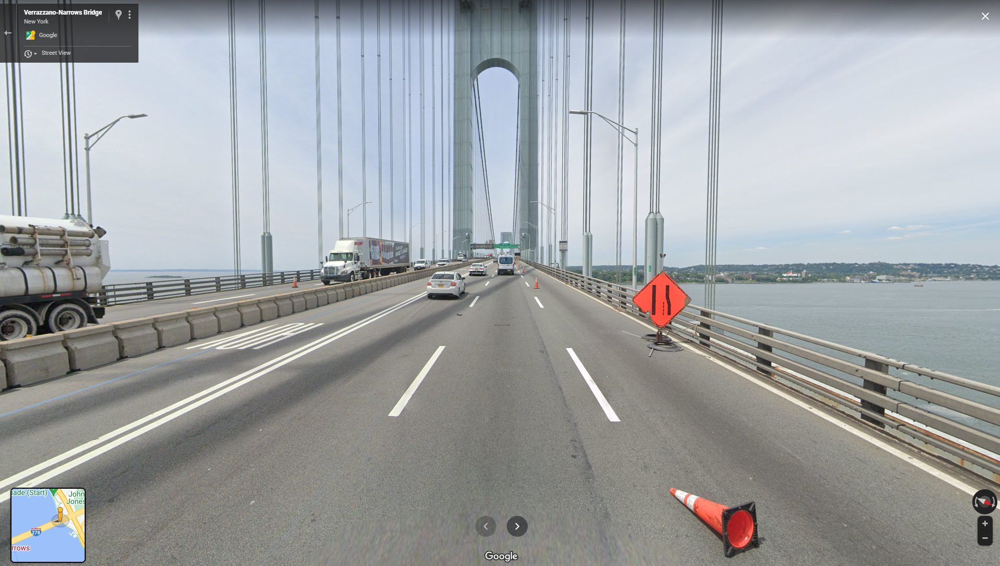

40.798256	-73.827440 | Whitestone Bridge

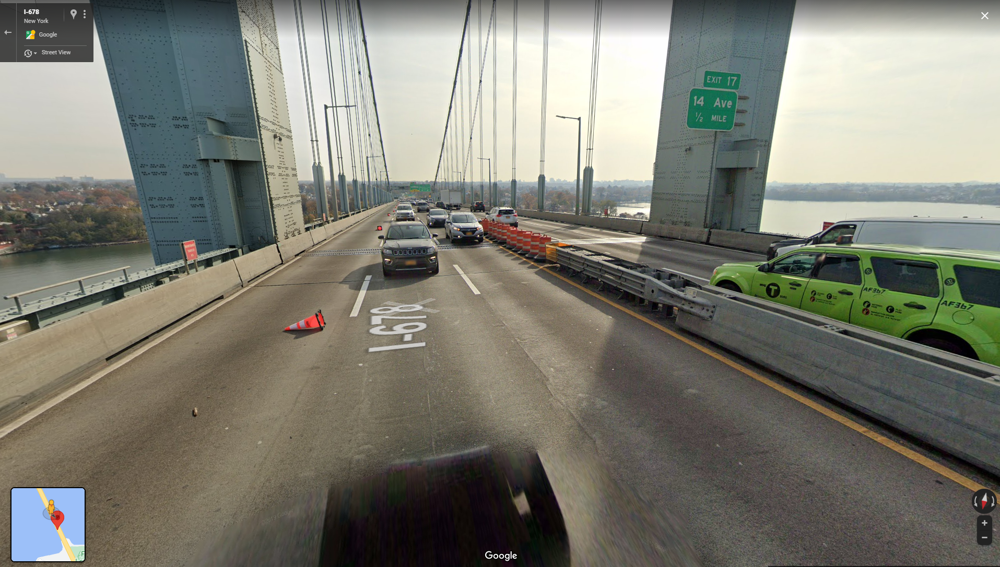

40.604153	-74.051980 | Verrazzano-Narrows Bridge (A picture was already shown)

40.861862	-73.912820 | W Fordham road and Major Deeggan Expy intersection

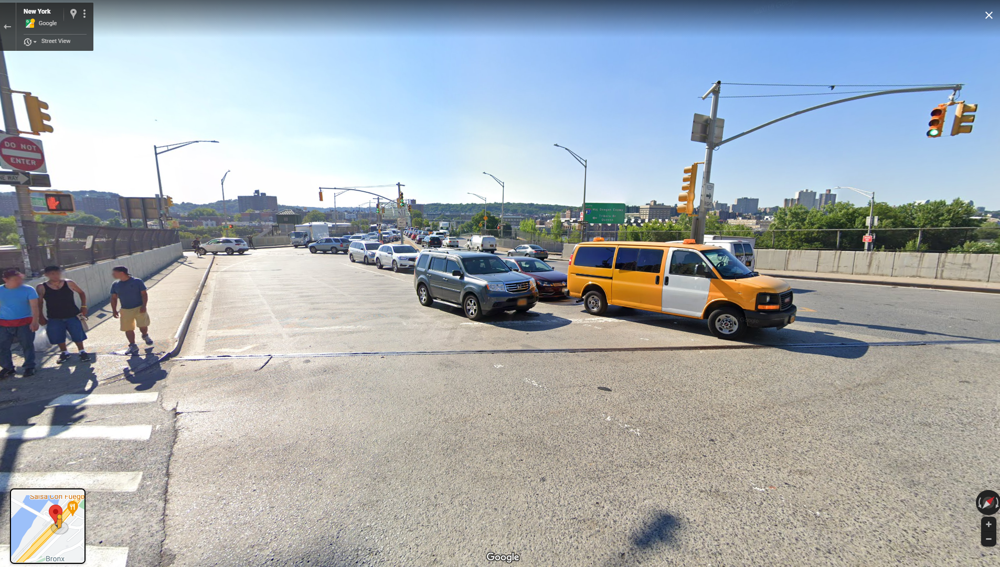

40.8047	-73.912430 | Msgr. Gerald J. Ryan blvd and Bruckner blvd intersection

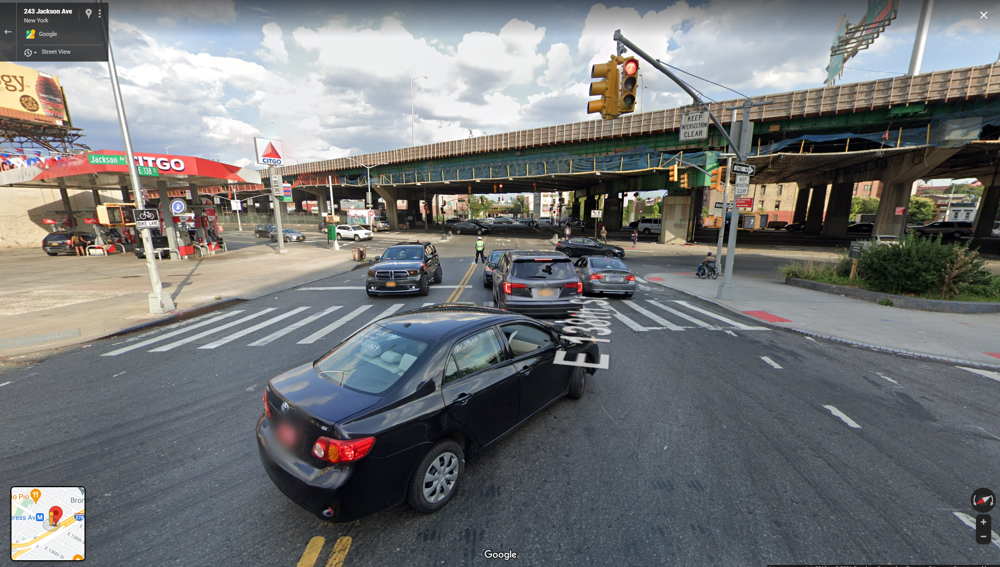

##Geographical Visualizations

In [69]:
collisions_df_original = collisions_df_load
#Removing Na from relevant columns
collisions_df_original = collisions_df_original[collisions_df_original['BOROUGH'].notna()]
collisions_df_original = collisions_df_original[collisions_df_original['LATITUDE'].notna()]
collisions_df_original = collisions_df_original[collisions_df_original['LONGITUDE'].notna()]

#Data Type conversions
collisions_df_original['LATITUDE']=collisions_df_original['LATITUDE'].astype('float').round(4)
collisions_df_original['LONGITUDE']=collisions_df_original['LONGITUDE'].astype('float').round(4)

collisions_df_original['NUMBER OF PERSONS INJURED']=collisions_df_original['NUMBER OF PERSONS INJURED'].fillna(0)
collisions_df_original['NUMBER OF PERSONS INJURED']=collisions_df_original['NUMBER OF PERSONS INJURED'].astype('int')

collisions_df_original['NUMBER OF PERSONS KILLED']=collisions_df_original['NUMBER OF PERSONS KILLED'].fillna(0)
collisions_df_original['NUMBER OF PERSONS KILLED']=collisions_df_original['NUMBER OF PERSONS KILLED'].astype('int')

collisions_df_original['NUMBER OF PEDESTRIANS INJURED']=collisions_df_original['NUMBER OF PEDESTRIANS INJURED'].fillna(0)
collisions_df_original['NUMBER OF PEDESTRIANS INJURED']=collisions_df_original['NUMBER OF PEDESTRIANS INJURED'].astype('int')

collisions_df_original['NUMBER OF PEDESTRIANS KILLED']=collisions_df_original['NUMBER OF PEDESTRIANS KILLED'].fillna(0)
collisions_df_original['NUMBER OF PEDESTRIANS KILLED']=collisions_df_original['NUMBER OF PEDESTRIANS KILLED'].astype('int')

collisions_df_original['NUMBER OF CYCLIST INJURED']=collisions_df_original['NUMBER OF CYCLIST INJURED'].fillna(0)
collisions_df_original['NUMBER OF CYCLIST INJURED']=collisions_df_original['NUMBER OF CYCLIST INJURED'].astype('int')

collisions_df_original['NUMBER OF CYCLIST KILLED']=collisions_df_original['NUMBER OF CYCLIST KILLED'].fillna(0)
collisions_df_original['NUMBER OF CYCLIST KILLED']=collisions_df_original['NUMBER OF CYCLIST KILLED'].astype('int')

collisions_df_original['NUMBER OF MOTORIST INJURED']=collisions_df_original['NUMBER OF MOTORIST INJURED'].fillna(0)
collisions_df_original['NUMBER OF MOTORIST INJURED']=collisions_df_original['NUMBER OF MOTORIST INJURED'].astype('int')

collisions_df_original['NUMBER OF MOTORIST KILLED']=collisions_df_original['NUMBER OF MOTORIST KILLED'].fillna(0)
collisions_df_original['NUMBER OF MOTORIST KILLED']=collisions_df_original['NUMBER OF MOTORIST KILLED'].astype('int')

#Deleting rows with incorrect lat long values 
collisions_df_original = collisions_df_original[collisions_df_original['LONGITUDE']!=0.0]
collisions_df_original = collisions_df_original[collisions_df_original['LATITUDE']!=0.0]

#Adding Data and Time Columns for creating data filter later.
collisions_df_original['CRASH DATE'] = pd.to_datetime(collisions_df_original['CRASH DATE'])
collisions_df_original['CRASH TIME'] = pd.to_datetime(collisions_df_original['CRASH TIME'])
collisions_df_original['Year'] = collisions_df_original['CRASH DATE'].dt.year
collisions_df_original['Month'] = collisions_df_original['CRASH DATE'].dt.month
collisions_df_original['Week'] = collisions_df_original['CRASH DATE'].dt.week
collisions_df_original['WeekDay'] = collisions_df_original['CRASH DATE'].dt.weekday
collisions_df_original['Hr'] = collisions_df_original['CRASH TIME'].dt.hour


In [70]:
#Renaming the columns for easier use throughout
collisions_df_original = collisions_df_original.rename(columns={"NUMBER OF PERSONS KILLED": "NUMBER_OF_PERSONS_KILLED", "NUMBER OF PERSONS INJURED": "NUMBER_OF_PERSONS_INJURED",
                                                                "NUMBER OF PEDESTRIANS INJURED":"NUMBER_OF_PEDESTRIANS_INJURED",
                                                                "NUMBER OF PEDESTRIANS KILLED":"NUMBER_OF_PEDESTRIANS_KILLED",
                                                                "NUMBER OF CYCLIST INJURED":"NUMBER_OF_CYCLIST_INJURED",
                                                                "NUMBER OF CYCLIST KILLED":"NUMBER_OF_CYCLIST_KILLED","NUMBER OF MOTORIST INJURED":"NUMBER_OF_MOTORIST_INJURED",
                                                                "NUMBER OF MOTORIST KILLED":"NUMBER_OF_MOTORIST_KILLED"})

#Creating an count column for each row
collisions_df_original["Accident_count"] = 1

In [71]:
collisions_df = collisions_df_original[(collisions_df_original['Year']==2019)]

### Number of Accidents in each Borough Per Square Km (2019)

As shown in the histograms above, all the years have more or less the same number of accidents (except for 2020 [Covid]), we look at the latest consistent year i.e. 2019

Since, we have the amazing geographical data, the idea is to give the user different geographical visualizations to be able to see and understand Motor Vehicle Collisions in the city of New York. We start from the bird eye's view and narrow it down to the very latitude and longitude of any collision also giving the user the options to filter the visuals accordingly. 

As a starting point, to engage the user, we plot the number of accidents per square Km in each Borough in the visually captivating Choropleth.

In [72]:
cols = ['BOROUGH', 'Accident_count']
#cols = ['BOROUGH', 'Accident_count' ,'NUMBER_OF_PERSONS_KILLED','NUMBER_OF_PERSONS_INJURED']
collisions_df = collisions_df[cols]
collisions_df = collisions_df.groupby(by=["BOROUGH"]).sum()
collisions_df.reset_index(level=0, inplace=True)

In [73]:
collisions_df["Area"] = 0
collisions_df.loc[(collisions_df['BOROUGH'] == "MANHATTAN"), "Area"] = 86.97
collisions_df.loc[(collisions_df['BOROUGH'] == "BROOKLYN"), "Area"] = 251.2
collisions_df.loc[(collisions_df['BOROUGH'] == "QUEENS"), "Area"] = 461
collisions_df.loc[(collisions_df['BOROUGH'] == "BRONX"), "Area"] = 147.6
collisions_df.loc[(collisions_df['BOROUGH'] == "STATEN ISLAND"), "Area"] = 265.5
collisions_df["Accident/Square Km"] = np.round(collisions_df["Accident_count"]/collisions_df["Area"])

In [74]:
di = {"MANHATTAN": "Manhattan", "BRONX": "Bronx", "BROOKLYN": "Brooklyn", "QUEENS": "Queens", "STATEN ISLAND": "Staten Island"}
collisions_df['BOROUGH']= collisions_df['BOROUGH'].map(di)  

In [75]:
# definition of the boundaries in the map
district_geo = r'new-york-city-boroughs.geojson'

In [77]:
ny_geo = gpd.read_file("new-york-city-boroughs.geojson")
ny_geo = ny_geo[['name','geometry']] 
#collisions_df.columns =['name', 'Accident_count' ,'NUMBER_OF_PERSONS_KILLED', 'NUMBER_OF_PERSONS_INJURED']
collisions_df.columns =['name', 'Accident_count','Area','Accident/Square Km']
nygeo_gdf=ny_geo.merge(collisions_df, on='name')


In [78]:
# Assigning centroids to map
x_map=nygeo_gdf.centroid.x.mean()
y_map=nygeo_gdf.centroid.y.mean()
print(x_map,y_map)

-73.95041937019667 40.71253941380421


In [79]:
# Creating a map object
ny_map_2= folium.Map(location=[y_map, x_map], zoom_start=10,tiles = "Open Street Map")
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(ny_map_2)


# Creating choropleth map
ny_map_2.choropleth(geo_data=nygeo_gdf,
             name='Choropleth',         
             data=nygeo_gdf,
             columns=["name", "Accident/Square Km"], 
             key_on='feature.properties.name', 
             fill_color='YlOrRd',
             fill_opacity=0.6, 
             line_opacity=0.8,
             legend_name='Accident/Square Km')

# Adding labels to map
style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
SuburbName = folium.features.GeoJson(
    nygeo_gdf,
    style_function=style_function, 
    control=False,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['name'
                ,'Accident/Square Km'
               ],
        aliases=['Borough: '
                ,'Accident/Square Km: '
                 ],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
ny_map_2.add_child(SuburbName)
ny_map_2.keep_in_front(SuburbName)
folium.LayerControl().add_to(ny_map_2)

ny_map_2

As expected, Manhattan (often refered to as the centre of the modern world)that's whe has the most accidents per square km followed by Brooklyn and then Bronx. (Brooklyn though has the highest number of accidents).

###Heat Map with Filters
Having had a bird view of the data, its time to get hands dirty. We will be looking at a heat map of the collisions with the option to filter a borough, an year and even the week. Furthermore, the user can look at the flow of traffic through a heat map movie at any given day of the week.

In [80]:
#Converting into string as widgets apparently only work with strings
collisions_df_original['Year'] = collisions_df_original['Year'].astype('str')
collisions_df_original['Month'] = collisions_df_original['Month'].astype('str')
collisions_df_original['Hr'] = collisions_df_original['Hr'].astype('str')
collisions_df_original['Week'] = collisions_df_original['Week'].astype('str')
collisions_df_original['WeekDay'] = collisions_df_original['WeekDay'].astype('str')

In [81]:
style = {'description_width': 'initial'}
layout = ipywidgets.Layout(height="auto", width="auto")


select_widget1 = ipywidgets.SelectMultiple(
    options=['BROOKLYN', 'BRONX', 'STATEN ISLAND', 'QUEENS', 'MANHATTAN'],
    value=['BROOKLYN', 'BRONX', 'STATEN ISLAND', 'QUEENS', 'MANHATTAN'],
    description='Borough',
    disabled=False
)

select_widget2 = ipywidgets.SelectMultiple(
    options=['2013','2014','2015','2016','2017','2018','2019','2020','2021'],
    value=['2019'],
    description='Year',
    disabled=False
)

select_widget3 = ipywidgets.SelectMultiple(
    options=['1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','23','24','25','26','27','28','29','30','31','32','33','34','35','36','37','38','39','40','41','42','43','44','45','46','47','48','49','50','51','52','53'],
    value=['52'],
    description='Week_Number',
    disabled=False
)

select_widget4 = ipywidgets.SelectMultiple(
    options=['0','1','2','3','4','5','6'],
    value=['0','1','2','3','4','5','6'],
    description='WeekDay',
    disabled=False
)

In [82]:
def update_map1(Borough,Year,Week,WeekDay):
     
    d=collisions_df_original[(collisions_df_original['BOROUGH'].isin(Borough)) & (collisions_df_original['Year'].isin(Year)) & (collisions_df_original['Week'].isin(Week)) & (collisions_df_original['WeekDay'].isin(WeekDay))]
    x_map=d.LATITUDE.mean()
    y_map=d.LONGITUDE.mean() 
    map_ny = folium.Map([x_map, y_map],tiles = "Stamen Toner", zoom_start=12) 
 
    d = d[['LONGITUDE','LATITUDE']]
    d = d.dropna(axis=0, subset=['LONGITUDE','LATITUDE'])

    heat_data = [[row['LATITUDE'],row['LONGITUDE']] for index, row in d.iterrows()]
    HeatMap(heat_data,radius=15, max_zoom=13).add_to(map_ny)
 
    display(map_ny)


In [83]:
ipywidgets.interactive(update_map1,Borough = select_widget1, Year=select_widget2, Week=select_widget3, WeekDay=select_widget4)

interactive(children=(SelectMultiple(description='Borough', index=(0, 1, 2, 3, 4), options=('BROOKLYN', 'BRONX…

It is the week of Christmas and The New Year. Time Square is definitely the busiest area of New York and hence the most number of accidents. 

Similarly, the user for instance the police can filter a Borough, the year, week and even the day to look at the hotspots for collisions and take necessary measures.

In [84]:
def update_map2(Borough,Year,Week,WeekDay):
     
    d=collisions_df_original[(collisions_df_original['BOROUGH'].isin(Borough)) & (collisions_df_original['Year'].isin(Year)) & (collisions_df_original['Week'].isin(Week)) & (collisions_df_original['WeekDay'].isin(WeekDay))]
    x_map=d.LATITUDE.mean()
    y_map=d.LONGITUDE.mean() 
    map_ny = folium.Map([x_map, y_map],tiles = "Stamen Toner", zoom_start=12) 
 
    d['Weight'] = d['Hr']
    d['Weight'] = d['Weight'].astype(float)
    data = d.dropna(axis=0, subset=['LONGITUDE','LATITUDE','Weight'])
    data = data[['LONGITUDE', 'LATITUDE','Weight']]

# List comprehension to make out list of lists
    heat_data = [[[row['LATITUDE'],row['LONGITUDE']] for index, row in data[data['Weight'] == i].iterrows()] for i in range(0,24)]

# Plot it on the map
    hm = plugins.HeatMapWithTime(heat_data,auto_play=True,max_opacity=0.8)
    hm.add_to(map_ny)

# Display the map
    display(map_ny)

In [85]:
select_widget1 = ipywidgets.SelectMultiple(
    options=['BROOKLYN', 'BRONX', 'STATEN ISLAND', 'QUEENS', 'MANHATTAN'],
    value=['BROOKLYN'],
    description='Borough',
    disabled=False
)

select_widget3 = ipywidgets.SelectMultiple(
    options=['1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','23','24','25','26','27','28','29','30','31','32','33','34','35','36','37','38','39','40','41','42','43','44','45','46','47','48','49','50','51','52','53'],
    value=['1','2','3','4','5','6','7','8','9','10','11','12','13'],
    description='Week_Number',
    disabled=False
)


In [86]:
ipywidgets.interactive(update_map2,Borough = select_widget1, Year=select_widget2, Week=select_widget3, WeekDay=select_widget4)

interactive(children=(SelectMultiple(description='Borough', index=(0,), options=('BROOKLYN', 'BRONX', 'STATEN …

The above Heat Map shows the accidents at different times of the day for the first quarter of the year 2019. (A quarter is chosen to have enough data for the heatmap to have enough data for a good visualization). By just looking at it, the Police can see as to at what time a certain areas is a hotspot for accidents

###Specific Location Map
Now, that the Police has an even better idea of what is going in the different Boroughs across different time periods, its time for
straw of the geogrphic Visualizations.

Along with the above filter, the user will now be able see the exact location of the accident. The marker would also provide additional valuable information about the collision.

In [87]:
collisions_df_original['CONTRIBUTING FACTOR VEHICLE 1'] = collisions_df_original['CONTRIBUTING FACTOR VEHICLE 1'].astype(str)
collisions_df_original['NUMBER_OF_PERSONS_KILLED'] = collisions_df_original['NUMBER_OF_PERSONS_KILLED'].astype(str)
collisions_df_original['NUMBER_OF_PERSONS_INJURED'] = collisions_df_original['NUMBER_OF_PERSONS_INJURED'].astype(str)
collisions_df_original['VEHICLE TYPE CODE 1'] = collisions_df_original['VEHICLE TYPE CODE 1'].astype(str)

In [88]:
collisions_df_original["Accident_Type"] = ""

collisions_df_original.loc[(collisions_df_original['NUMBER_OF_PEDESTRIANS_INJURED'] > 0) | (collisions_df_original['NUMBER_OF_PEDESTRIANS_KILLED'] > 0), "Accident_Type"] = "Pedestrian"

collisions_df_original.loc[(collisions_df_original['NUMBER_OF_CYCLIST_INJURED'] > 0) | (collisions_df_original['NUMBER_OF_CYCLIST_KILLED'] > 0), "Accident_Type"] = "Cyclist"

collisions_df_original.loc[(collisions_df_original['NUMBER_OF_MOTORIST_INJURED'] > 0) | (collisions_df_original['NUMBER_OF_MOTORIST_KILLED'] > 0), "Accident_Type"] = "Motorist"


In [89]:
collisions_df_original['ON/CROSS STREET NAME'] = collisions_df_original['ON STREET NAME'] + " " + collisions_df_original['CROSS STREET NAME']

In [90]:
select_widget1 = ipywidgets.SelectMultiple(
    options=['BROOKLYN', 'BRONX', 'STATEN ISLAND', 'QUEENS', 'MANHATTAN'],
    value=['BROOKLYN'],
    description='Borough',
    disabled=False
)

select_widget2 = ipywidgets.SelectMultiple(
    options=['2013','2014','2015','2016','2017','2018','2019','2020','2021'],
    value=['2019'],
    description='Year',
    disabled=False
)

select_widget3 = ipywidgets.SelectMultiple(
    options=['1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','23','24','25','26','27','28','29','30','31','32','33','34','35','36','37','38','39','40','41','42','43','44','45','46','47','48','49','50','51','52','53'],
    value=['52'],
    description='Week_Number',
    disabled=False
)

select_widget4 = ipywidgets.SelectMultiple(
    options=['0','1','2','3','4','5','6'],
    value=['0'],
    description='WeekDay',
    disabled=False
)

select_widget5 = ipywidgets.Text(value='', placeholder='type here', description='On/Cross Street Name:')
select_widget5.style.handle_color = 'lightblue'

In [91]:
def update_map3(Borough,Year,Week,WeekDay,name):
    
    if (name == ''):

        d=collisions_df_original[(collisions_df_original['BOROUGH'].isin(Borough)) & (collisions_df_original['Year'].isin(Year)) & (collisions_df_original['Week'].isin(Week)) & (collisions_df_original['WeekDay'].isin(WeekDay))]
        x_map=d.LATITUDE.mean()
        y_map=d.LONGITUDE.mean() 
        map_ny = folium.Map([x_map, y_map],tiles = "Open Street Map", zoom_start=12, height= '80%') 

        d.apply(lambda row: folium.CircleMarker(location=[row['LATITUDE'], row['LONGITUDE']],popup = 'Accident Type: ' + row.loc['Accident_Type'] + ', Cause of Accident(Vehicle 1): ' + row.loc['CONTRIBUTING FACTOR VEHICLE 1'] + ', Type of Vehicle 1: ' + row.loc['VEHICLE TYPE CODE 1'] + ', Injured = ' + row.loc['NUMBER_OF_PERSONS_INJURED'] + ', Killed = ' + row.loc['NUMBER_OF_PERSONS_KILLED'],radius = 3, fill = True, fill_opacity=1).add_to(map_ny), axis=1)
        display(map_ny)
    else:
        d=collisions_df_original[(collisions_df_original['BOROUGH'].isin(Borough)) & (collisions_df_original['Year'].isin(Year)) & (collisions_df_original['Week'].isin(Week)) & (collisions_df_original['WeekDay'].isin(WeekDay)) & collisions_df_original['ON/CROSS STREET NAME'].str.contains(name)]
        x_map=d.LATITUDE.mean()
        y_map=d.LONGITUDE.mean()
        map_ny = folium.Map([x_map, y_map],tiles = "Open Street Map", zoom_start=12, height= '80%') 
        
        d.apply(lambda row: folium.CircleMarker(location=[row['LATITUDE'], row['LONGITUDE']],popup = 'Accident Type: ' + row.loc['Accident_Type'] + ', Cause of Accident(Vehicle 1): ' + row.loc['CONTRIBUTING FACTOR VEHICLE 1'] + ', Type of Vehicle 1: ' + row.loc['VEHICLE TYPE CODE 1'] + ', Injured = ' + row.loc['NUMBER_OF_PERSONS_INJURED'] + ', Killed = ' + row.loc['NUMBER_OF_PERSONS_KILLED'] ,radius = 3, fill = True, fill_opacity=1).add_to(map_ny), axis=1)
        display(map_ny)


In [92]:
ipywidgets.interactive(update_map3,Borough = select_widget1, Year=select_widget2, Week=select_widget3, WeekDay=select_widget4,name = select_widget5)

interactive(children=(SelectMultiple(description='Borough', index=(0,), options=('BROOKLYN', 'BRONX', 'STATEN …

### Geographical Exploratory Analysis (Failure to Yield Visualization)

Looking at the different contributing factors of an accidents to find out the one causing the highest number of accidents

In [93]:
visual1 = pd.DataFrame(collisions_df_original.groupby(['CONTRIBUTING FACTOR VEHICLE 1'])['Accident_count'].count().nlargest(20))
visual = visual1.reset_index()

In [94]:
import plotly.express as px
fig = px.bar(visual, x="CONTRIBUTING FACTOR VEHICLE 1",y = "Accident_count", width=800, height=400,title="Top Contributing Factor for Accidents")

# Set titles
fig.update_layout(
    yaxis_title="Number of Accidents",
    xaxis_title="CONTRIBUTING FACTOR VEHICLE 1",
    autosize=True,
    width=600,
    height=600,
    )

fig.show()


As expected, Driver Inattention/Distraction is ofcourse the number one reason for accidents (Phone calls, food and what not). What is interesting is to look at the second highest reason for accidents. 

As the 'Failure to Yield Right-of-Way' mostly happen at the intersections, it would be interesting to see the top 50 streets with the highest number of such accidents geographically on the map

In [95]:
list = ['Failure to Yield Right-of-Way']
collisions_df = collisions_df_original[collisions_df_original['CONTRIBUTING FACTOR VEHICLE 1'].isin(list)]

x = pd.DataFrame(collisions_df.groupby(['BOROUGH','ON STREET NAME'])['Accident_count'].count().nlargest(50))
x = x.reset_index()
streets = x['ON STREET NAME'].tolist()

collisions_df = collisions_df[collisions_df['ON STREET NAME'].isin(streets)]
collisions_df['ON STREET NAME'] = collisions_df['ON STREET NAME'].str.strip()
streets = x['ON STREET NAME'].str.strip().tolist()

In [96]:
collisions_df['CONTRIBUTING FACTOR VEHICLE 1'] = collisions_df['CONTRIBUTING FACTOR VEHICLE 1'].astype(str)
collisions_df['NUMBER_OF_PERSONS_KILLED'] = collisions_df['NUMBER_OF_PERSONS_KILLED'].astype(str)
collisions_df['NUMBER_OF_PERSONS_INJURED'] = collisions_df['NUMBER_OF_PERSONS_INJURED'].astype(str)
collisions_df['VEHICLE TYPE CODE 1'] = collisions_df['VEHICLE TYPE CODE 1'].astype(str)

collisions_df["Accident_Type"] = ""

collisions_df.loc[(collisions_df['NUMBER_OF_PEDESTRIANS_INJURED'] > 0) | (collisions_df['NUMBER_OF_PEDESTRIANS_KILLED'] > 0), "Accident_Type"] = "Pedestrian"

collisions_df.loc[(collisions_df['NUMBER_OF_CYCLIST_INJURED'] > 0) | (collisions_df['NUMBER_OF_CYCLIST_KILLED'] > 0), "Accident_Type"] = "Cyclist"

collisions_df.loc[(collisions_df['NUMBER_OF_MOTORIST_INJURED'] > 0) | (collisions_df['NUMBER_OF_MOTORIST_KILLED'] > 0), "Accident_Type"] = "Motorist"

In [97]:
select_widget1 = ipywidgets.SelectMultiple(
    options=['BROOKLYN', 'BRONX', 'STATEN ISLAND', 'QUEENS', 'MANHATTAN'],
    value=['BROOKLYN', 'BRONX', 'STATEN ISLAND', 'QUEENS', 'MANHATTAN'],
    description='Borough',
    disabled=False
)

select_widget2 = ipywidgets.SelectMultiple(
    options=['2013','2014','2015','2016','2017','2018','2019','2020','2021'],
    value=['2019'],
    description='Year',
    disabled=False
)

select_widget3 = ipywidgets.SelectMultiple(
    options=['1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','23','24','25','26','27','28','29','30','31','32','33','34','35','36','37','38','39','40','41','42','43','44','45','46','47','48','49','50','51','52','53'],
    value=['1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','23','24','25','26','27','28','29','30','31','32','33','34','35','36','37','38','39','40','41','42','43','44','45','46','47','48','49','50','51','52','53'],
    description='Week_Number',
    disabled=False
)

select_widget4 = ipywidgets.SelectMultiple(
    options=['0','1','2','3','4','5','6'],
    value=['0','1','2','3','4','5','6'],
    description='WeekDay',
    disabled=False
)

select_widget5 = ipywidgets.SelectMultiple(
    options=streets,
    value = ['BROADWAY'],
    description='Streets',
    disabled=False
)


In [98]:
def update_map3(Borough,Year,Week,WeekDay,street):
    
    d=collisions_df[(collisions_df['BOROUGH'].isin(Borough)) & (collisions_df['Year'].isin(Year)) & (collisions_df['Week'].isin(Week)) & (collisions_df_original['WeekDay'].isin(WeekDay)) & (collisions_df['ON STREET NAME'].isin(street))]
    x_map=d.LATITUDE.mean()
    y_map=d.LONGITUDE.mean() 
    map_ny = folium.Map([x_map, y_map],tiles = "Open Street Map", zoom_start=12, height= '80%') 

    d.apply(lambda row: folium.CircleMarker(location=[row['LATITUDE'], row['LONGITUDE']],popup = 'Accident Type: ' + row.loc['Accident_Type']  + ', Type of Vehicle 1: ' + row.loc['VEHICLE TYPE CODE 1'] + ', Injured = ' + row.loc['NUMBER_OF_PERSONS_INJURED'] + ', Killed = ' + row.loc['NUMBER_OF_PERSONS_KILLED'],radius = 3, fill = True, fill_opacity=1).add_to(map_ny), axis=1)
    display(map_ny)
    

In [99]:
ipywidgets.interactive(update_map3,Borough = select_widget1, Year = select_widget2,Week=select_widget3, WeekDay=select_widget4,street = select_widget5)

interactive(children=(SelectMultiple(description='Borough', index=(0, 1, 2, 3, 4), options=('BROOKLYN', 'BRONX…

Investigating this map, the NYPD can find out the crossing with the highest number of accidents and need to be fixed

### Data Exports to JSON for website

In [100]:
# heatmap_data_0 = heatmap_data[heatmap_data['CRASH TIME'] == 0]
# heatmap_data_1 = heatmap_data[heatmap_data['CRASH TIME'] == 1]
# heatmap_data_2 = heatmap_data[heatmap_data['CRASH TIME'] == 2]
# heatmap_data_3 = heatmap_data[heatmap_data['CRASH TIME'] == 3]
# heatmap_data_4 = heatmap_data[heatmap_data['CRASH TIME'] == 4]
# heatmap_data_5 = heatmap_data[heatmap_data['CRASH TIME'] == 5]
# heatmap_data_6 = heatmap_data[heatmap_data['CRASH TIME'] == 6]
# heatmap_data_7 = heatmap_data[heatmap_data['CRASH TIME'] == 7]
# heatmap_data_8 = heatmap_data[heatmap_data['CRASH TIME'] == 8]
# heatmap_data_9 = heatmap_data[heatmap_data['CRASH TIME'] == 9]
# heatmap_data_10 = heatmap_data[heatmap_data['CRASH TIME'] == 10]
# heatmap_data_11 = heatmap_data[heatmap_data['CRASH TIME'] == 11]
# heatmap_data_12 = heatmap_data[heatmap_data['CRASH TIME'] == 12]
# heatmap_data_13 = heatmap_data[heatmap_data['CRASH TIME'] == 13]
# heatmap_data_14 = heatmap_data[heatmap_data['CRASH TIME'] == 14]
# heatmap_data_15 = heatmap_data[heatmap_data['CRASH TIME'] == 15]
# heatmap_data_16 = heatmap_data[heatmap_data['CRASH TIME'] == 16]
# heatmap_data_17 = heatmap_data[heatmap_data['CRASH TIME'] == 17]
# heatmap_data_18 = heatmap_data[heatmap_data['CRASH TIME'] == 18]
# heatmap_data_19 = heatmap_data[heatmap_data['CRASH TIME'] == 19]
# heatmap_data_20 = heatmap_data[heatmap_data['CRASH TIME'] == 20]
# heatmap_data_21 = heatmap_data[heatmap_data['CRASH TIME'] == 21]
# heatmap_data_22 = heatmap_data[heatmap_data['CRASH TIME'] == 22]
# heatmap_data_23 = heatmap_data[heatmap_data['CRASH TIME'] == 23]

In [101]:
# heatmap_data_0.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_0.json')
# heatmap_data_1.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_1.json')
# heatmap_data_2.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_2.json')
# heatmap_data_3.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_3.json')
# heatmap_data_4.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_4.json')
# heatmap_data_5.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_5.json')
# heatmap_data_6.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_6.json')
# heatmap_data_7.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_7.json')
# heatmap_data_8.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_8.json')
# heatmap_data_9.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_9.json')
# heatmap_data_10.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_10.json')
# heatmap_data_11.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_11.json')
# heatmap_data_12.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_12.json')
# heatmap_data_13.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_13.json')
# heatmap_data_14.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_14.json')
# heatmap_data_15.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_15.json')
# heatmap_data_16.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_16.json')
# heatmap_data_17.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_17.json')
# heatmap_data_18.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_18.json')
# heatmap_data_19.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_19.json')
# heatmap_data_20.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_20.json')
# heatmap_data_21.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_21.json')
# heatmap_data_22.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_22.json')
# heatmap_data_23.to_json(r'SocialData_FinalProject/data/hours/heatmap_data_23.json')

# Genre

Initially, it was decided to show slide show as the genre for visualization as the idea was to give lot of insights in a short span of time within limited space. However, as the analysis was developed, it made more sense to give the user as much power as possible. Interactive visualization thus became a common theme for the major part of our website. As already seen it includes widgets, dropdowns as simple selections in the visual space.

Given the above context, **magazine style**  with a **martini glass structure** is each subparts was chosen. It gave a very neat and continious look and feel to our website.

##Visual Narrative

Since its a magazine, a progress bar makes sense for **visual Structuring**.

As we have a lot of geographical graphs, zooming and motion is inherently present in most of the visualizations for **Highlights**

A mix of Continuity Editing and Object Continuity is used for **Transition Guidance** as we want to tell a story.


## Narative Structure

The **Ordering** of the website is very interesting. It is a mix of Random Access, Linearity and User Directed Path depending on how the user wishes to interact with it.

The website is specifically very high on **Interactivity** as the focus is to enable the user to create their own stories. There is a mix of filters, selections, details and stimulating default views to completely engage the user.

**Messaging** - Headlines, introductions and comments support the wesbite throughout.

#Visualizations

**Bar Graphs**

Bar graphs are easy to understand and to use. That is why we utilized them in several occasions. Simple ones were used to showcase some concise points we wanted to make







**Geographical Plots**

Given that the data was rich geographically, doing some kinds of geographical plots was always going to to be there. But, as the analysis and exploration  went on, a lot of cool and interesting ways to see the same dataset were found. The filtering widgets especially, they gave the visuals a whole another dimension and wherein one could imagine the user doing all sorts of analysis of their own. It is liking having a collsions map available all the time with some really nice filters.

Each of the visual and the rationale behind each of them is of course explained in the data analysis part of the notebook.

# Discussions

## What went well?

A successful data analysis of the New York city vehicle collision data was carried out. The group has managed to conduct exploratory and explanatory data analysis. The strengths of the project is the geographical analysis were we managed to create many different interactive visualizations from which many conclusions can be drawn. The graphs were used to draw insights about the dangerous areas in NewYork and the weak parts in the infrastructure. These visualizations can be further used by the audience to identify other insights or build on top of the insights we have declared. Another strong point of our project is the analysis of several aspects of the data. A temporal analysis, a geographical analysis, collision factor analysis and machine learning were utilized to learn more about the data. Many different visualizations were created. With them we explored how collision counts and severities with respect to year, time of year, time of day, location of collision, factor leading to collision, vehicle types involved in the collision and so on. This analysis could lead to changes in infrastructure, vehicle engineering and the way driving is seen by the society

## What is still missing? What could be improved?, Why?

The project lacks in a more thorough collision factor and collision vehicle type analysis. A more in-depth dive into how different factors combined with variables like the time of the crash and location affect the chance of collision and the severity of them. Some analysis was done but there is still more to do. This would help with the previously mentioned changes to be implemented. An area where more analysis is needed is the Machine Learning part. Different algorithms could be tried out to reach better prediction accuracy and from there a better representation of the variables leading to a more severe accident could be extracted. Algorithms like Support vector machine and neural networks could be utilized for this. To further enhance the analysis and the predictions additional datasets could be used. Combining the New York city collision data together with New York’s weather data could result in some interesting insights. Perhaps bad weather conditions expose some weak or critical parts of the infrastructure. Bad weather could also lead to poor visibility or difficult driving which might increase the number of collision or the severity of them. Another step that could be taken is to include a dataset where the flow of the traffic is described. This way the relation between the number of vehicles on the road vs the number of collisions could be analyzed.

#Contribution

**Motivation**: Sameer

**Imports and data loading**: Sameer, Marius, Adam

**Dataset exploration**: Marius, Sameer, Adam

**Temporal analysis**: Marius

**Machine Learning**: Marius

**Interactive bar graphs in dash**: Adam

**Maximum collision coordinates**: Marius

**Geographical visualizations**: Sameer

**Genre**: Sameer

**Visualizations**: Sameer

**Discussions**: Marius


**Fixing the explainer notebook**: Sameer, Marius

**Creating website**:Adam


It was a very well managed group effort with every team member taking responsibility. Weekly call were made to discuss the progress as well as explain what each of us had done.